# **Fraud detection using Autoencoders **



Objective :
    Create a network that is able to classify a transaction as a fraud or not .

**Summary**
*   Importing libraries
*   The dataset
*   The dataset
*   Data preprocessing
*   Creating the data loader
*   Creating the Autoencoder
*   Training the network
*   Network evaluation
*   Testing the network
*   Evaluation metrics
*   Conclusion

In [ ]:
pip install pandas scipy numpy

In [ ]:
import pandas as pd
import scipy as stats
import numpy as np
import pickle
import matplotlib.pyplot as plt
from scipy import stats
import tensorflow as tf
import seaborn as sns
from pylab import rcParams
from sklearn.model_selection import train_test_split
from keras.models import Model, load_model
from keras.layers import Input, Dense
from keras.callbacks import ModelCheckpoint, TensorBoard
from keras import regularizers
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline


%matplotlib inline

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 14, 8

RANDOM_SEED = 42
LABELS = ["Normal", "Fraud"]

In [ ]:
print("salam")

salam


##  Loading the data
# 🔹 Data overview :

In [ ]:
from google.colab import files

uploaded = files.upload()  # Sélectionnez le fichier CSV depuis votre PC

Saving application_data.csv to application_data.csv


In [ ]:
data=pd.read_csv('application_data.csv')

In [ ]:
data.describe(include='all')

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511,307511,307511,307511,307511.000000,3.075110e+05,3.075110e+05,307499.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
unique,NaN,NaN,2,3,2,2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Cash loans,F,N,Y,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,278232,202448,202924,213312,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,278180.518577,0.080729,NaN,NaN,NaN,NaN,0.417052,1.687979e+05,5.990260e+05,27108.573909,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,NaN,NaN,NaN,NaN,0.722121,2.371231e+05,4.024908e+05,14493.737315,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,NaN,NaN,NaN,NaN,0.000000,2.565000e+04,4.500000e+04,1615.500000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,NaN,NaN,NaN,NaN,0.000000,1.125000e+05,2.700000e+05,16524.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,NaN,NaN,NaN,NaN,0.000000,1.471500e+05,5.135310e+05,24903.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,NaN,NaN,NaN,NaN,1.000000,2.025000e+05,8.086500e+05,34596.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000


In [ ]:
data.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=122)

In [ ]:
data.dtypes

,0
SK_ID_CURR,int64
TARGET,int64
NAME_CONTRACT_TYPE,object
CODE_GENDER,object
FLAG_OWN_CAR,object
...,...
AMT_REQ_CREDIT_BUREAU_DAY,float64
AMT_REQ_CREDIT_BUREAU_WEEK,float64
AMT_REQ_CREDIT_BUREAU_MON,float64
AMT_REQ_CREDIT_BUREAU_QRT,float64


<ipython-input-10-3656160052>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  plot = sns.barplot(x = 'labels', y = "Target", data = df, palette = ['Steelblue', 'red'])


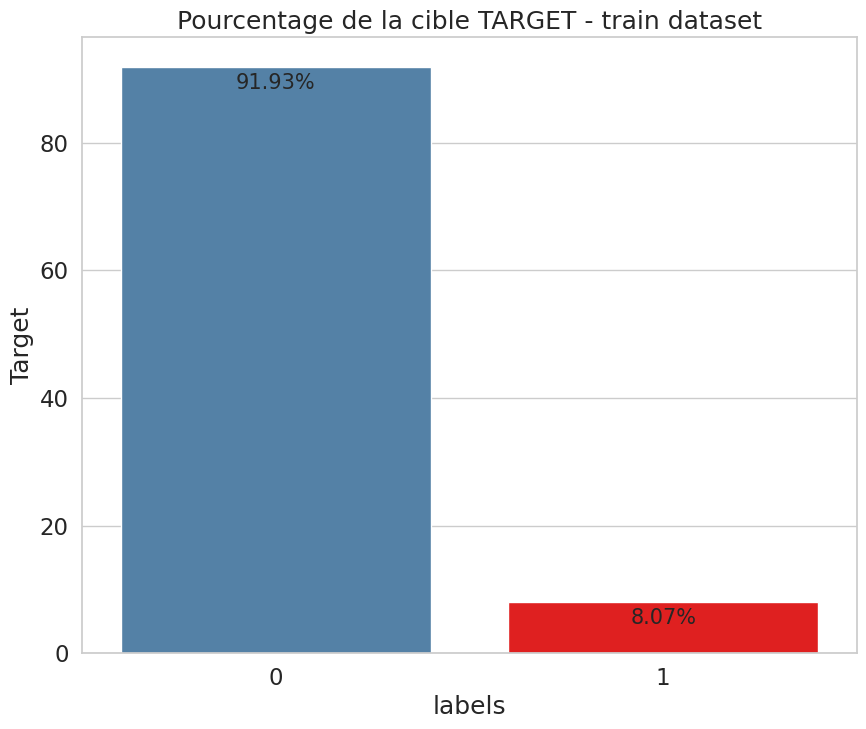

In [ ]:
temp = data["TARGET"].value_counts()
df = pd.DataFrame({'labels': temp.index,
                   'Target': temp.values/temp.values.sum()*100
                  })
plt.figure(figsize = (10,8))
plt.title('Pourcentage de la cible TARGET - train dataset')
# sns.set_color_codes("pastel")
plot = sns.barplot(x = 'labels', y = "Target", data = df, palette = ['Steelblue', 'red'])
locs, labels = plt.xticks()

# add percentage annotation

for p in plot.patches :
    plot.annotate('{:.2f}%'.format(p.get_height()),
                 (p.get_x() + p.get_width() / 2., p.get_height()),
                  ha = 'center', va = 'center',
                  size = 15,
                  xytext = (0, -12),
                  textcoords = 'offset points')

plt.savefig('target percentage', dpi=200, bbox_inches='tight')
plt.show()

✈Comme one peut le constater les 2 classes 0 et 1 sont fortement désequilibrés avec 91.9% des clients non-défaillants et 8% seulement des clients défaillants avec un défaut de paiement ou plus. Il faut prendre ce désequilibre en compte dans la classification

✈
On peut constater qu'il y a des valeurs dans train qui ne sont pas dans test comme :
'XNA' dans CODE_GENDER
'Maternity leave' dans NAME_INCOME_TYPE
'Unknown' dans NAME_FAMILY_STATUS
Pour toutes les autres variables catégorielles nous avons les memes valeurs dans les 2 sets. Est ce que ces valeurs sont nombreuses?

In [ ]:
data.loc[data['CODE_GENDER'] == 'XNA']


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
35657,141289,0,Revolving loans,XNA,Y,Y,0,207000.0,382500.0,19125.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
38566,144669,0,Revolving loans,XNA,N,Y,2,157500.0,270000.0,13500.0,...,0,0,0,0,0.0,0.0,0.0,3.0,0.0,4.0
83382,196708,0,Revolving loans,XNA,N,Y,1,135000.0,405000.0,20250.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
189640,319880,0,Revolving loans,XNA,Y,Y,0,247500.0,540000.0,27000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,6.0


In [ ]:
data.loc[data['NAME_INCOME_TYPE'] == 'Maternity leave' ]


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
48949,156685,0,Revolving loans,M,N,N,0,360000.0,765000.0,76500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
109612,227123,0,Revolving loans,F,N,Y,2,135000.0,810000.0,40500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
218269,352877,1,Cash loans,F,N,Y,2,67500.0,1435500.0,40896.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
291432,437628,1,Cash loans,F,Y,Y,2,49500.0,423000.0,11286.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
295458,442305,0,Revolving loans,F,N,Y,1,90000.0,315000.0,15750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
data.loc[data['NAME_FAMILY_STATUS'] == 'Unknown' ]


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
41982,148605,0,Revolving loans,M,N,Y,0,450000.0,675000.0,33750.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
187348,317181,0,Revolving loans,F,N,Y,0,202500.0,585000.0,29250.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
data = data[(data['CODE_GENDER'] != 'XNA') & (data['NAME_INCOME_TYPE'] != 'Maternity leave') & (data['NAME_FAMILY_STATUS'] != 'Unknown')]


 On peut constater que plusieurs variables contiennent des valeurs aberrantes comme AMT_INCOME_TOTAL de 100 millions dollars pour un demandeur de credit (pourquoi pas!). On va traiter celles qui sont évidentes comme l'age et la durée d'emploi actuel


In [ ]:
# DAYS_BIRTH
(data['DAYS_BIRTH'] / -365).describe()

,DAYS_BIRTH
count,307500.000000
mean,43.937176
std,11.956134
min,20.517808
25%,34.008219
50%,43.150685
75%,53.923288
max,69.120548


In [ ]:
(data['DAYS_EMPLOYED'] / -365).describe()


,DAYS_EMPLOYED
count,307500.000000
mean,-174.842272
std,387.062275
min,-1000.665753
25%,0.791781
50%,3.323288
75%,7.561644
max,49.073973


In [ ]:
anom_days_emp = data.loc[data['DAYS_EMPLOYED'] > 0]
anom_values = anom_days_emp['DAYS_EMPLOYED'].unique()
print(len(anom_days_emp))
print(anom_values)

55374
[365243]


In [ ]:
# Remplace la valeur abérrante par NaN
data['DAYS_EMPLOYED'].replace(anom_values, np.nan, inplace = True)

<ipython-input-18-2837698320>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['DAYS_EMPLOYED'].replace(anom_values, np.nan, inplace = True)


In [ ]:
df

,labels,Target
0,0,91.927118
1,1,8.072882


## 🔹 Data Preprocessing :

 * 🔹 Handling Imbalanced Data :







In [ ]:
import pandas as pd
import numpy as np

def preprocess_data(file_path):
    # Charger les données
    data = pd.read_csv(file_path)

    # Séparer la cible
    if 'TARGET' in data.columns:
        target = data['TARGET']
        data = data.drop(['TARGET'], axis=1)
    else:
        target = None

    # Supprimer l'identifiant s'il est présent
    if 'SK_ID_CURR' in data.columns:
        data = data.drop(['SK_ID_CURR'], axis=1)

    data['CODE_GENDER'] = data['CODE_GENDER'].replace('XNA', 'F')
    data['ORGANIZATION_TYPE'] = data['ORGANIZATION_TYPE'].replace('XNA', 'Other')
    # Supprimer les colonnes avec >50% de valeurs manquantes
    missing_pct = data.isnull().mean() * 100
    high_missing = missing_pct[missing_pct > 90].index
    data = data.drop(columns=high_missing)

    # Identifier types de colonnes
    cat_cols = data.select_dtypes(include=['object', 'category']).columns
    num_cols = data.select_dtypes(include=['float64', 'int64']).columns

    # Remplir les NaN
    for col in data.columns:
        if data[col].isnull().any():
            if col in num_cols:
                data[col] = data[col].fillna(data[col].median())
            else:
                data[col] = data[col].fillna('missing')

    # Remplacer les valeurs 'XNA' si présentes
    if 'CODE_GENDER' in data.columns:
        data['CODE_GENDER'] = data['CODE_GENDER'].replace('XNA', 'F')
    if 'ORGANIZATION_TYPE' in data.columns:
        data['ORGANIZATION_TYPE'] = data['ORGANIZATION_TYPE'].replace('XNA', 'Other')


    #
     # Remplacer les outliers (IQR) par les bornes
    for col in num_cols:
        Q1 = data[col].quantile(0.25)
        Q3 = data[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR

        # Remplacer les outliers par les bornes (inférieure ou supérieure)
        data[col] = np.where(data[col] < lower, lower, data[col])
        data[col] = np.where(data[col] > upper, upper, data[col])

    return data, target


In [ ]:
df, target = preprocess_data('application_data.csv')

In [ ]:
numericals_columns=df.select_dtypes(include=['float64','int64']).columns
categorical_columns=df.select_dtypes(include=['object','category']).columns

In [ ]:
len(numericals_columns)

104

In [ ]:
len(categorical_columns)

16

In [ ]:
df['TARGET']=target

<ipython-input-25-3907692028>:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['TARGET']=target


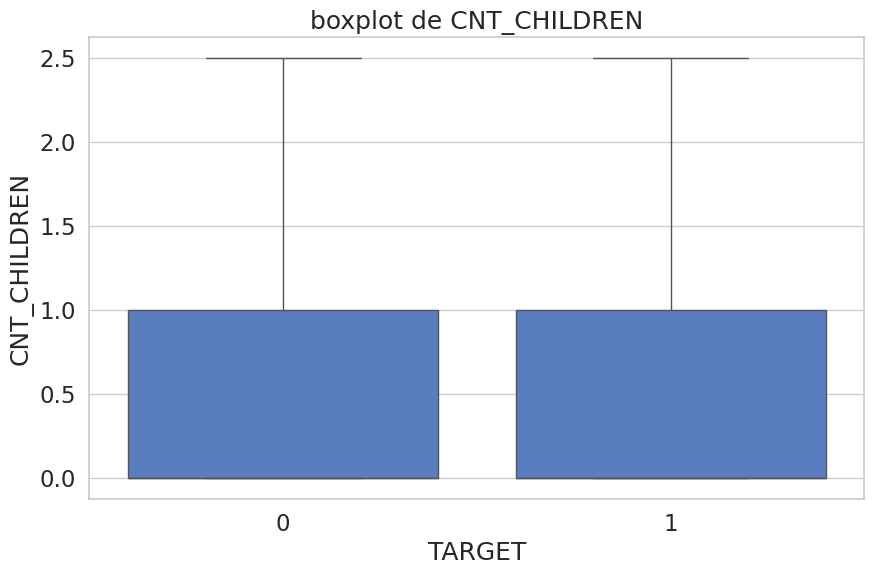

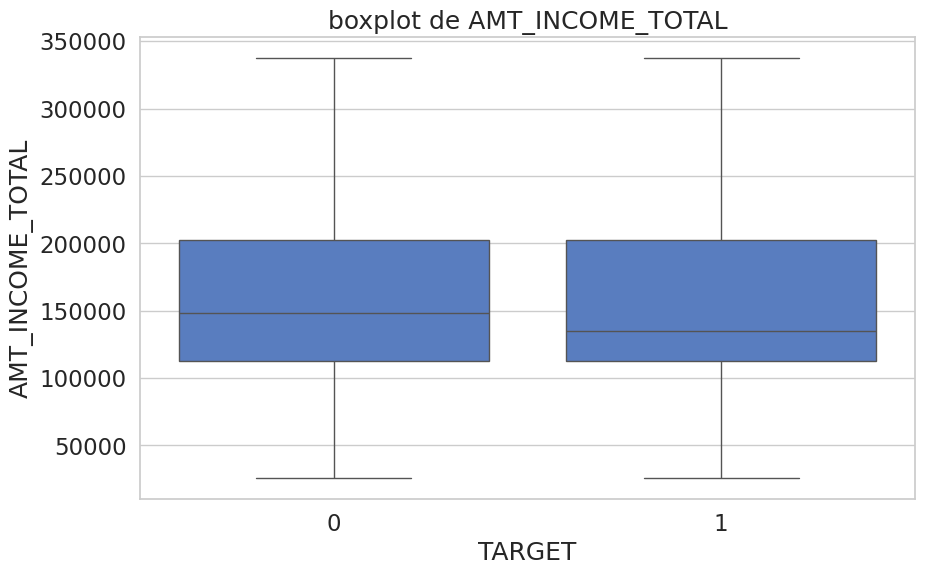

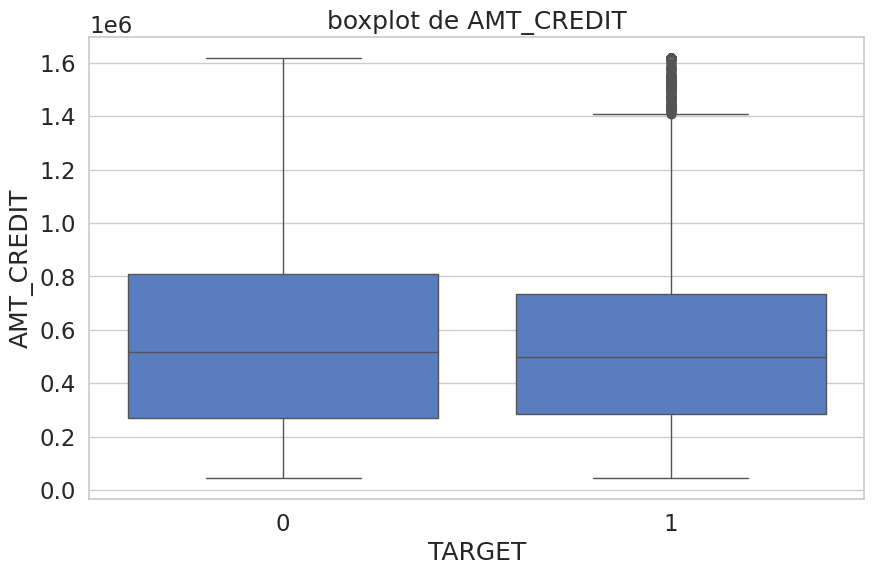

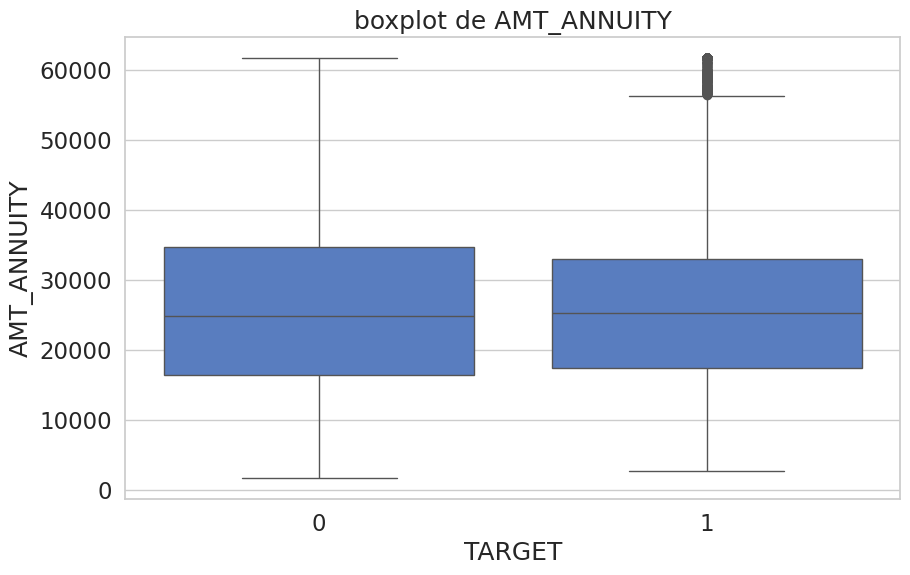

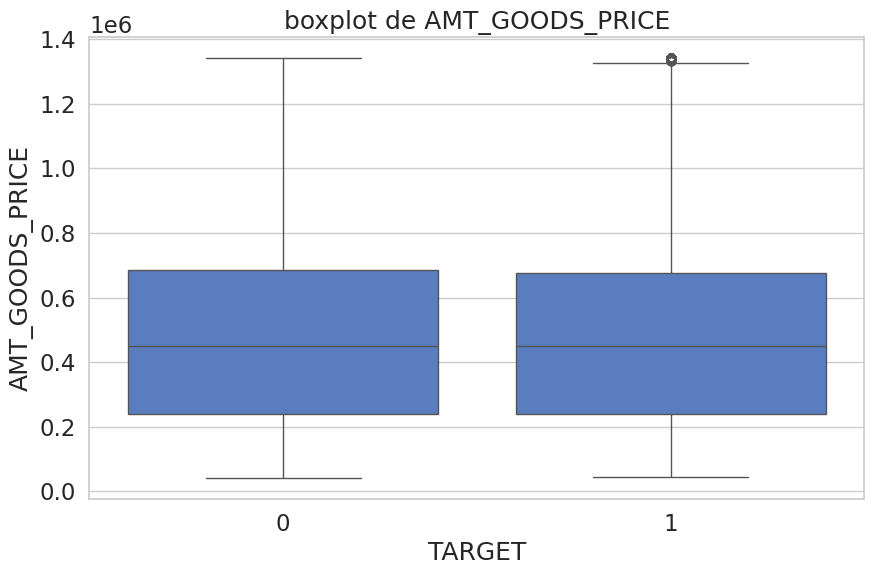

...

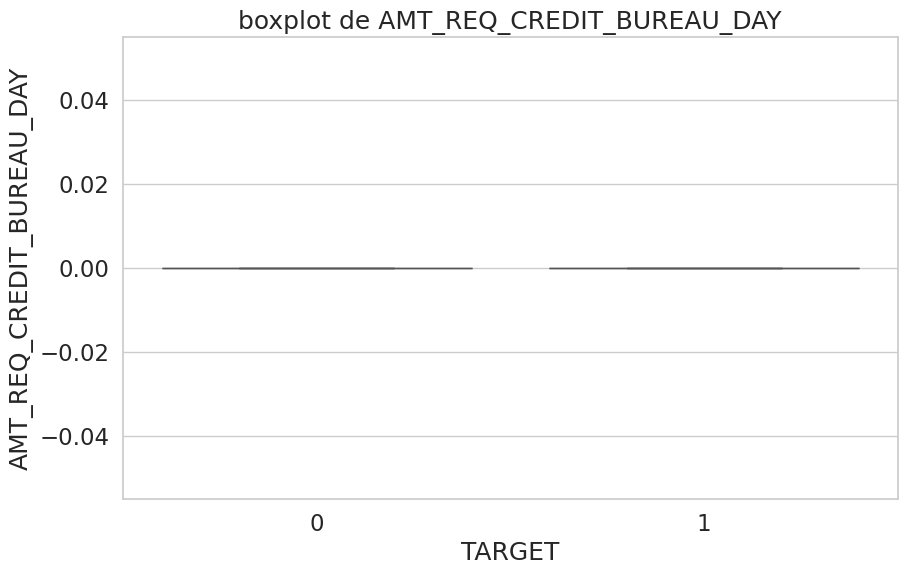

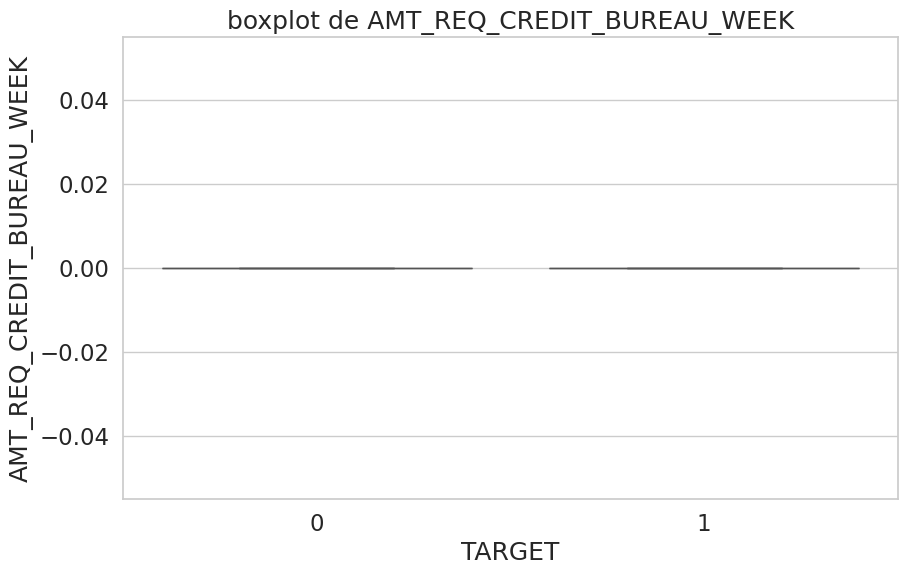

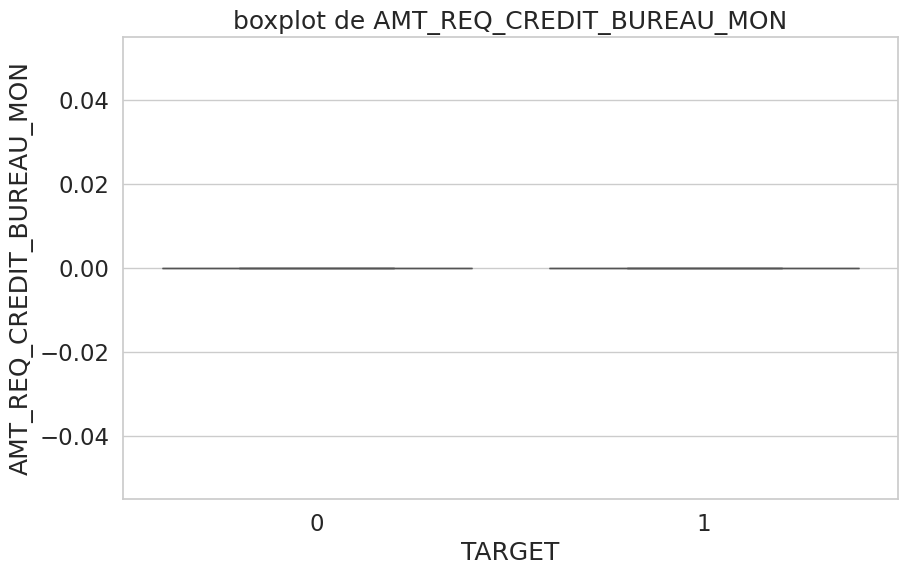

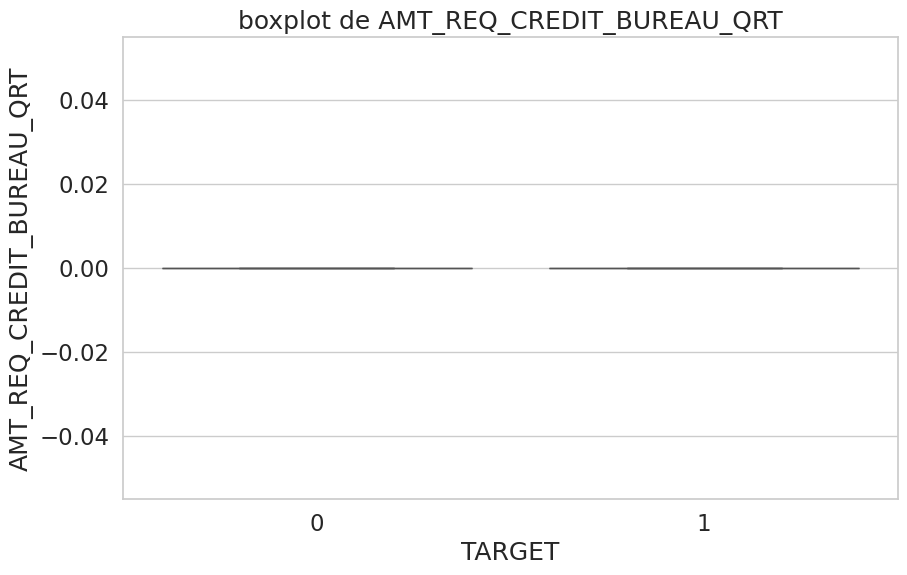

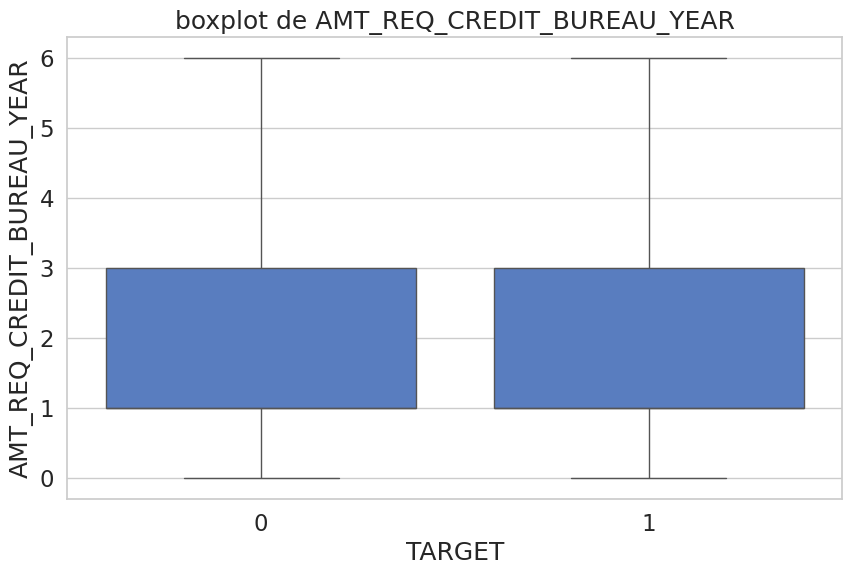

In [ ]:
for col in numericals_columns:
    plt.figure(figsize=(10,6))
    sns.boxplot(x='TARGET',y=col,data=df)
    plt.title(f'boxplot de {col}')
    plt.show()

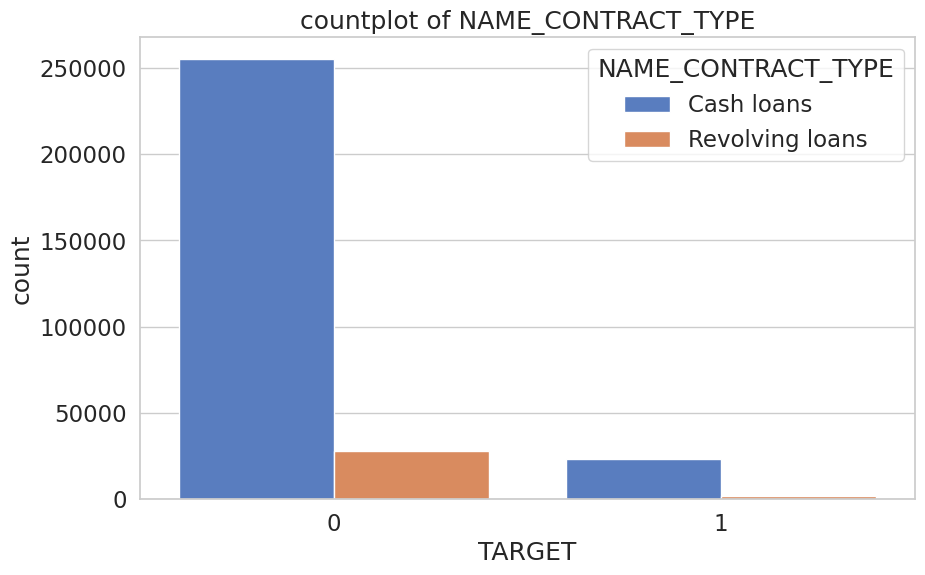

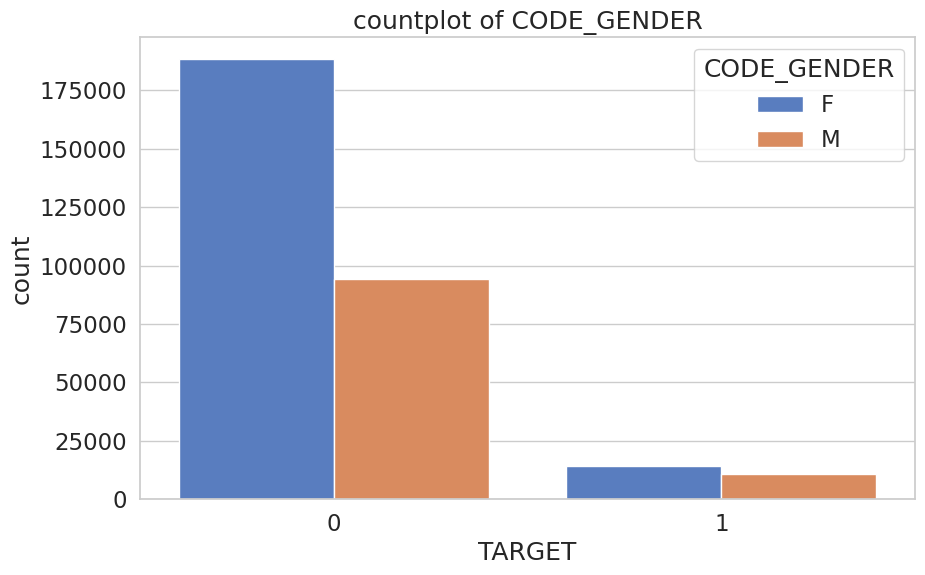

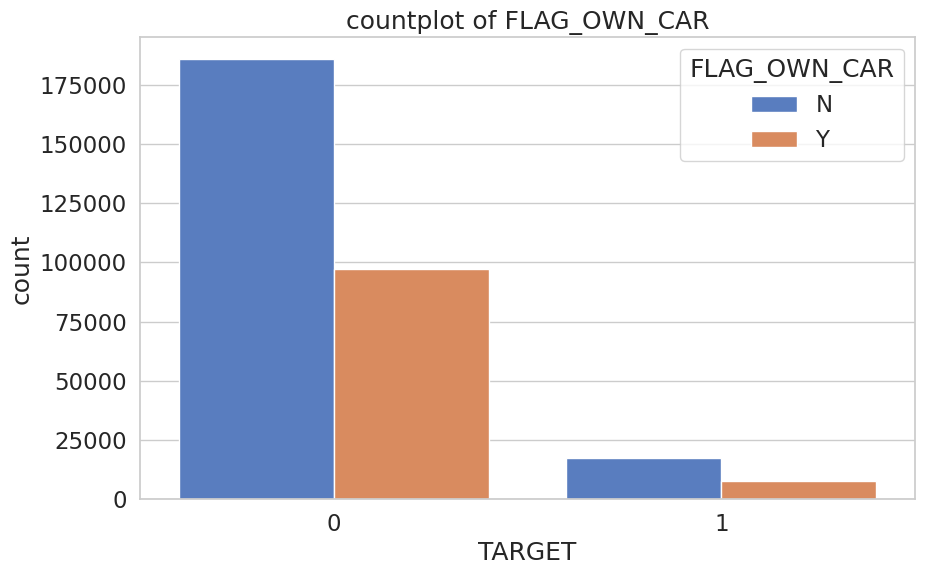

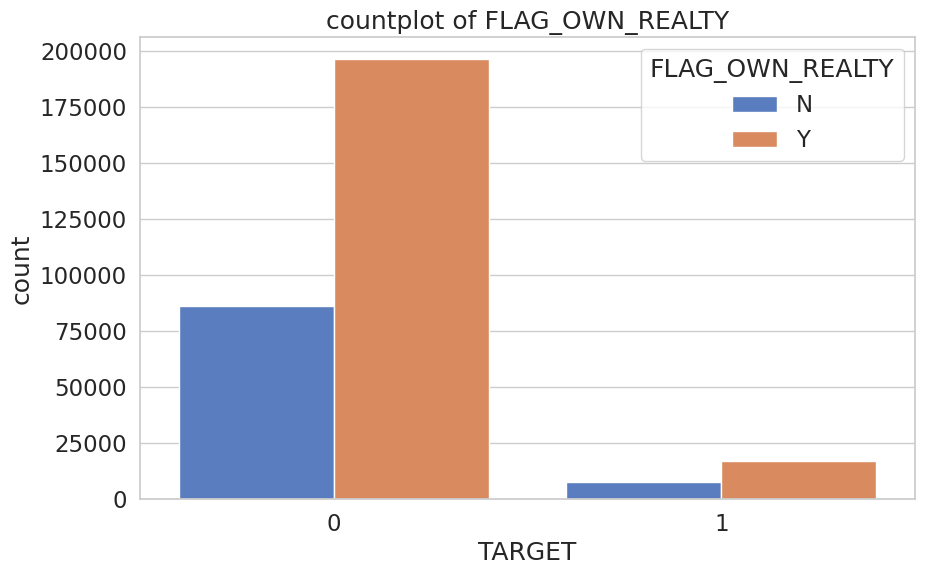

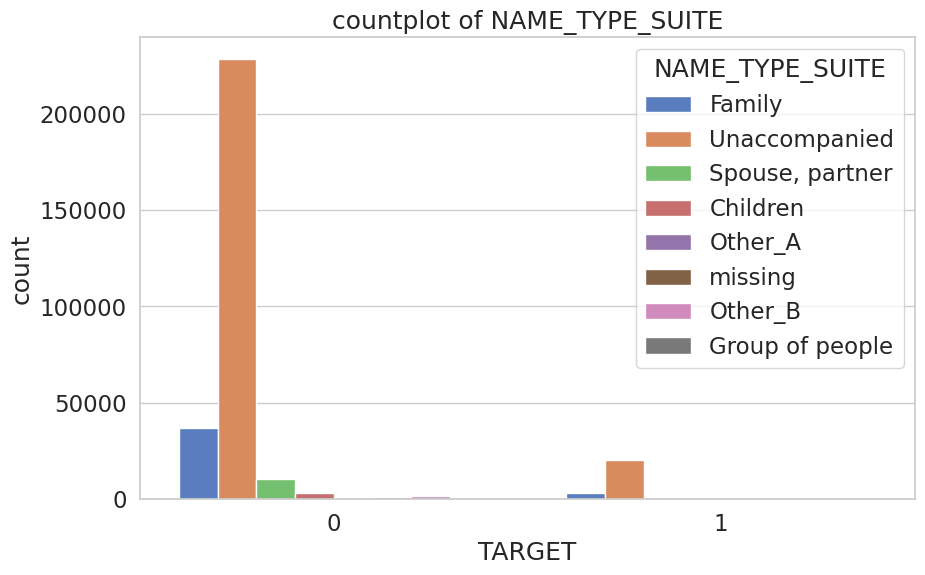

...

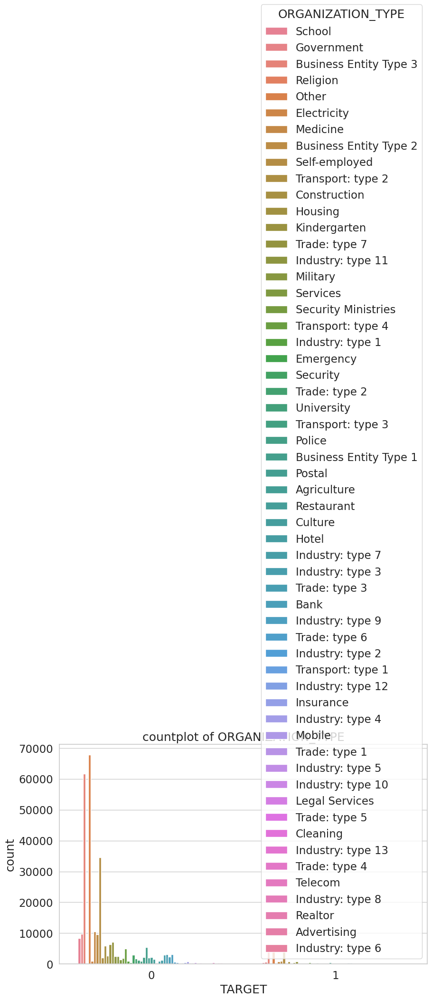

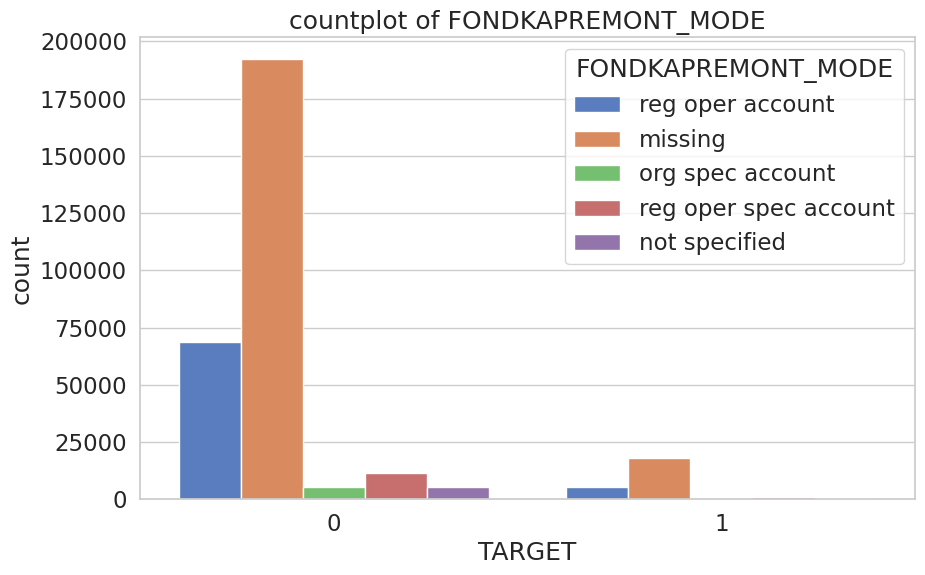

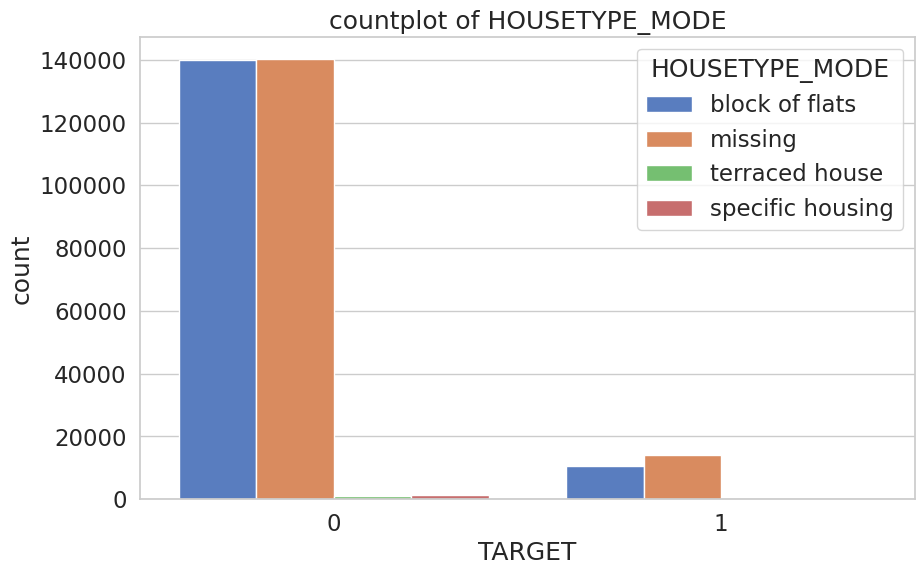

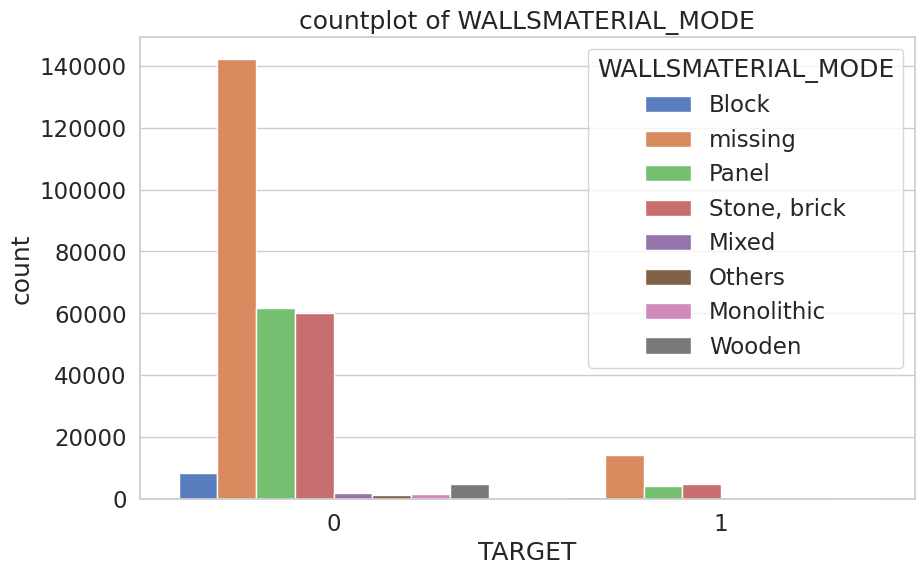

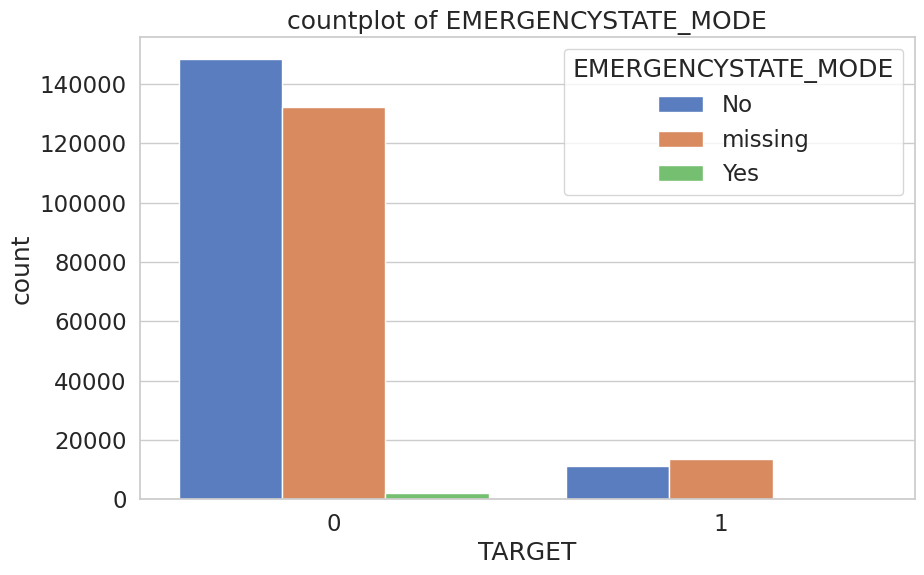

In [ ]:
for col in categorical_columns:
   plt.figure(figsize=(10,6))
   sns.countplot(x='TARGET',hue=col,data=df)
   plt.title(f'countplot of {col}')
   plt.show()

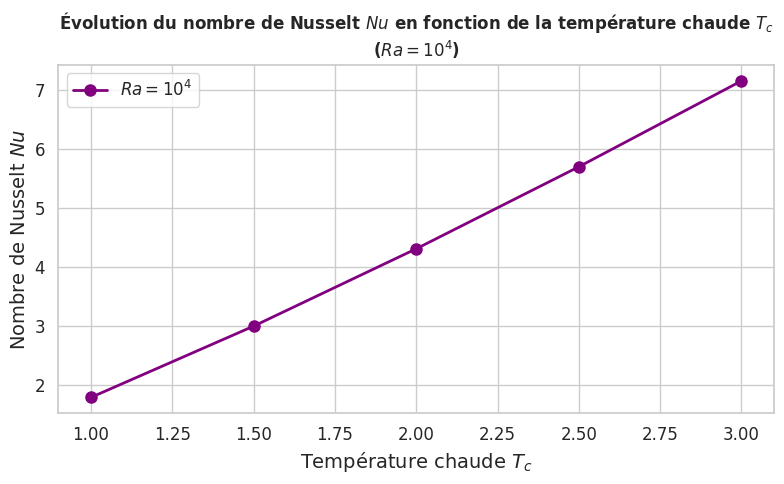

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Style professionnel
sns.set(style="whitegrid")
plt.rcParams.update({
    "font.size": 12,
    "axes.labelsize": 14,
    "axes.titlesize": 16,
    "legend.fontsize": 12,
    "xtick.labelsize": 12,
    "ytick.labelsize": 12,
    "figure.figsize": (8, 5),
    "lines.linewidth": 2,
    "lines.markersize": 8
})

# Données
Tc = [1.0000, 1.5000, 2.0000, 2.5000, 3.0000]
Nu = [1.7918, 2.9995, 4.3106, 5.7006, 7.1561]

# Tracé
plt.plot(Tc, Nu, marker='o', linestyle='-', color='purple', label='$Ra = 10^4$')

# Titres et axes
plt.title('Évolution du nombre de Nusselt $Nu$ en fonction de la température chaude $T_c$\n($Ra = 10^4$)', fontsize=12, weight='bold')
plt.xlabel('Température chaude $T_c$')
plt.ylabel('Nombre de Nusselt $Nu$')
plt.legend(loc='upper left')

# Affichage
plt.tight_layout()
plt.savefig("nu_vs_Tc_Ra1e4.png", dpi=300)
plt.show()


In [ ]:
missing=df.isnull().sum()
missing[missing>0]
df['OCCUPATION_TYPE'].value_counts()

,count
OCCUPATION_TYPE,
missing,96391
Laborers,55186
Sales staff,32102
Core staff,27570
Managers,21371
Drivers,18603
High skill tech staff,11380
Accountants,9813
Medicine staff,8537


In [ ]:
df['WEEKDAY_APPR_PROCESS_START'].value_counts()

,count
WEEKDAY_APPR_PROCESS_START,
TUESDAY,53901
WEDNESDAY,51934
MONDAY,50714
THURSDAY,50591
FRIDAY,50338
SATURDAY,33852
SUNDAY,16181


# 🔹 encodage des variables quantitatives :

In [ ]:
def encode_features(df):
    cat_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()

    binary_cols = [col for col in cat_cols if df[col].nunique() == 2]
    nominal_cols = [col for col in cat_cols if df[col].nunique() > 2 and col not in binary_cols]
    nominal_cols.remove('WEEKDAY_APPR_PROCESS_START')
    ordinal_cols = ['WEEKDAY_APPR_PROCESS_START']

    df_encoded = df.copy()

    # Encodage one-hot
    encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
    for col in nominal_cols:
        encoded = encoder.fit_transform(df_encoded[[col]])
        encoded_df = pd.DataFrame(encoded, columns=encoder.get_feature_names_out([col]), index=df_encoded.index)
        df_encoded = pd.concat([df_encoded.drop(columns=col), encoded_df], axis=1)

    # Encodage ordinal
    df_encoded['WEEKDAY_APPR_PROCESS_START'] = df_encoded['WEEKDAY_APPR_PROCESS_START'].astype(str).str.strip().str.capitalize()
    weekday_mapping = {
        'Monday': 0, 'Tuesday': 1, 'Wednesday': 2,
        'Thursday': 3, 'Friday': 4, 'Saturday': 5, 'Sunday': 6
    }
    df_encoded['WEEKDAY_APPR_PROCESS_START'] = df_encoded['WEEKDAY_APPR_PROCESS_START'].map(weekday_mapping)

    # Encodage binaire
    binary_mapping = {
        'NAME_CONTRACT_TYPE': {'Cash loans': 0, 'Revolving loans': 1},
        'CODE_GENDER': {'M': 0, 'F': 1},
        'FLAG_OWN_CAR': {'N': 0, 'Y': 1},
        'FLAG_OWN_REALTY': {'N': 0, 'Y': 1}
    }
    for col, mapping in binary_mapping.items():
        if col in df_encoded.columns:
            df_encoded[col] = df_encoded[col].map(mapping)

    return df_encoded,num_cols,cat_cols

In [ ]:
data_encoded,numerical_columns,categorical_columns= encode_features(df)

In [ ]:
numerical_columns.remove('TARGET')
print(len(numerical_columns))

104


In [ ]:
print(len(categorical_columns))
categorical_columns

16


['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE']

In [ ]:
num_disc=[col for col in numerical_columns if data_encoded[col].nunique() <8]
num_cont=[col for col in numerical_columns if col not in num_disc ]
print(num_disc)
print(len(num_disc))
print(num_cont)
print(len(num_cont))
df[num_disc].head()

['CNT_CHILDREN', 'OWN_CAR_AGE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_1', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_ME

,CNT_CHILDREN,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,0.0,9.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,9.0,1.0,1.0,0.0,1.0,1.0,0.0,2.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,9.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,9.0,1.0,1.0,0.0,1.0,0.0,0.0,2.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,9.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
data_encoded.shape

(307511, 239)

In [ ]:
cols=data_encoded.columns

In [ ]:
data_encoded['TARGET']=data['TARGET']

In [ ]:
  binary_cols = [col for col in cols if data_encoded[col].nunique() == 2]
  nominal_cols = [col for col in cols if data_encoded[col].nunique() > 2 and col not in binary_cols]
  qui_cols=[col for col in cols if data_encoded[col].nunique() < 2]


In [ ]:
len(nominal_cols)

23

In [ ]:
len(binary_cols)

136

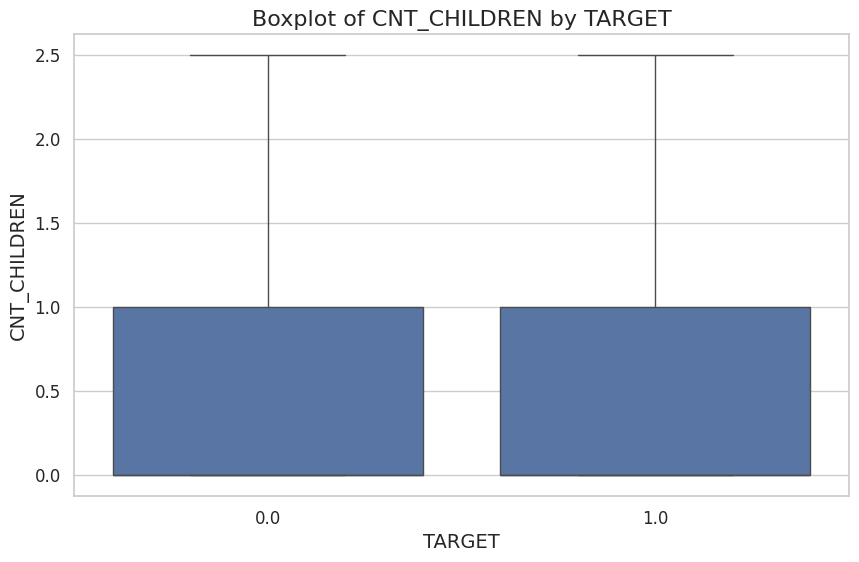

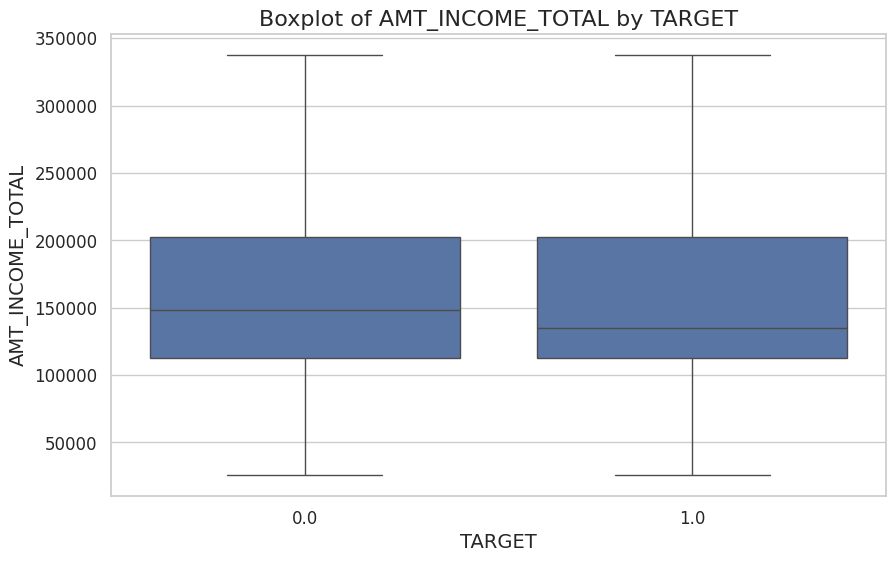

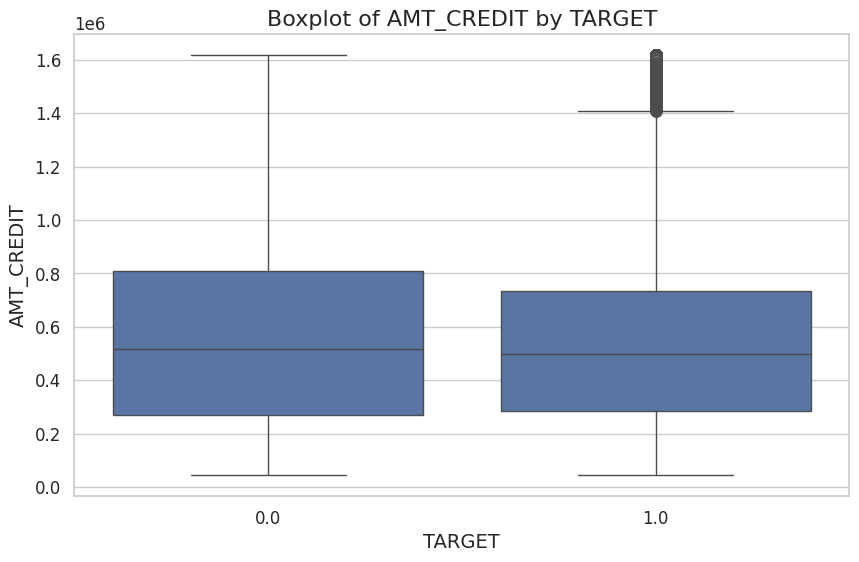

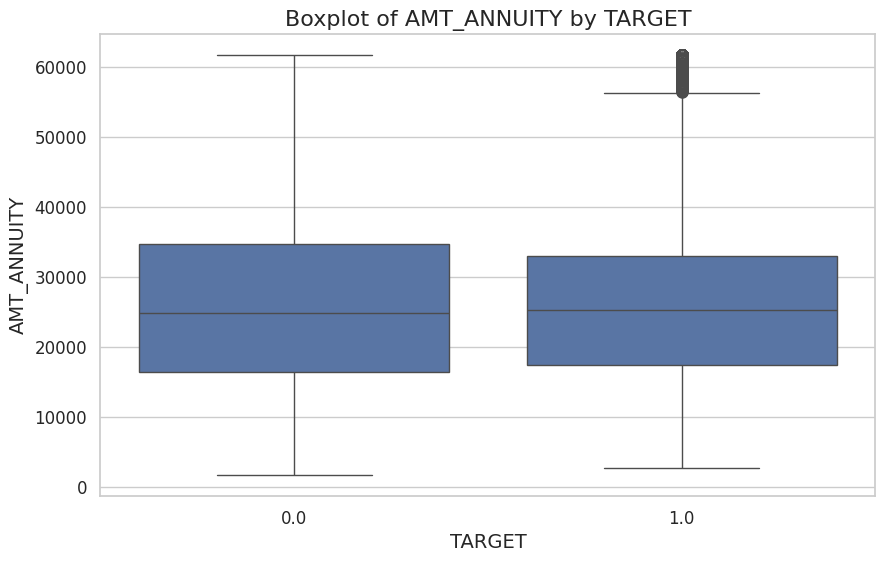

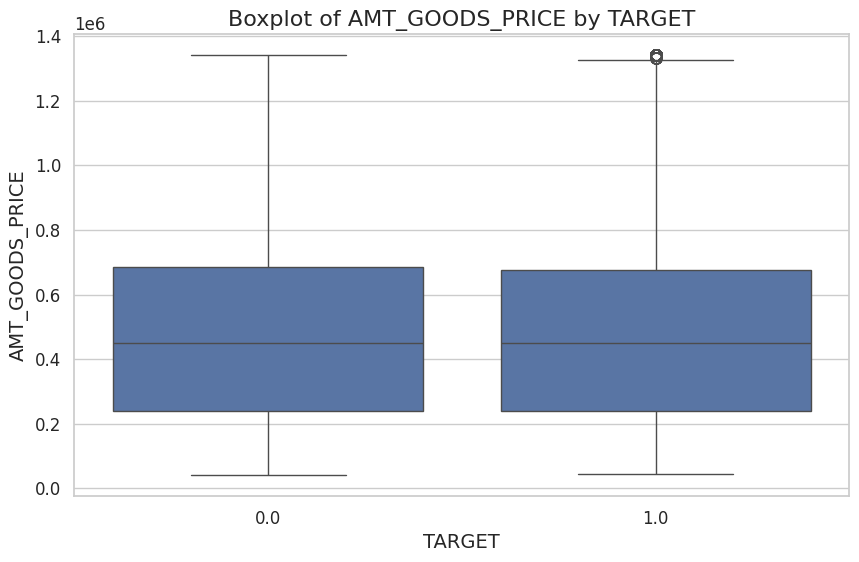

...

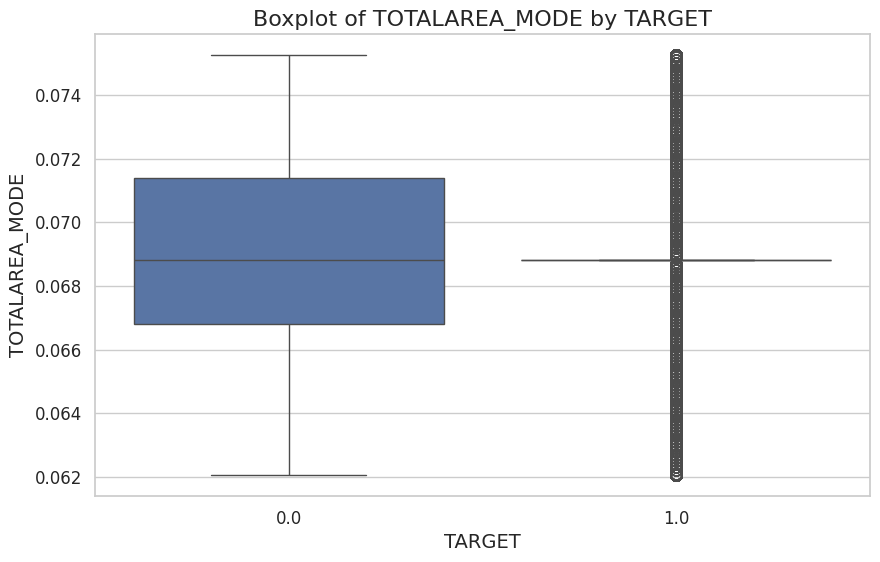

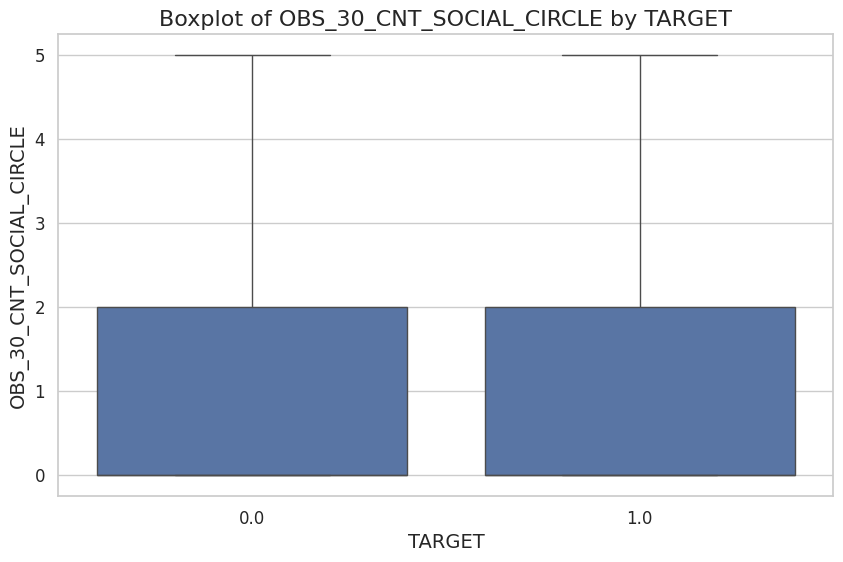

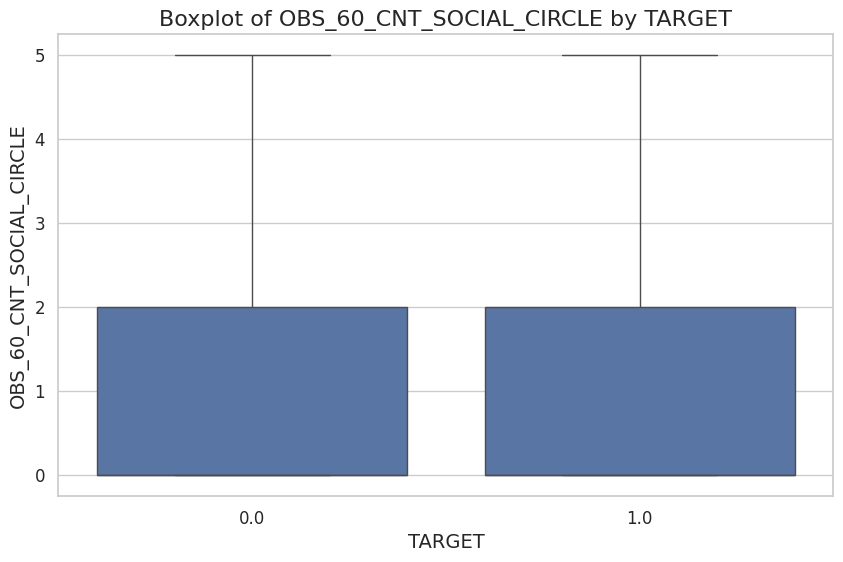

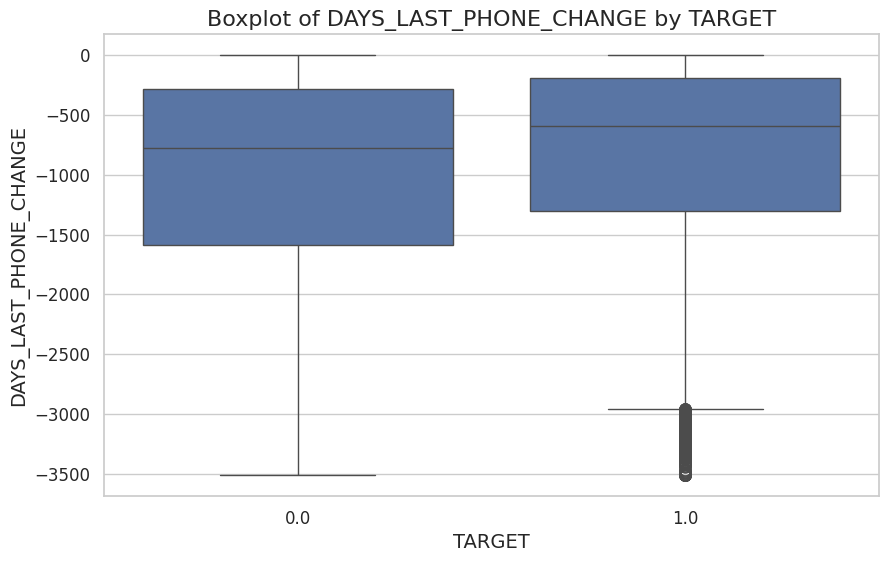

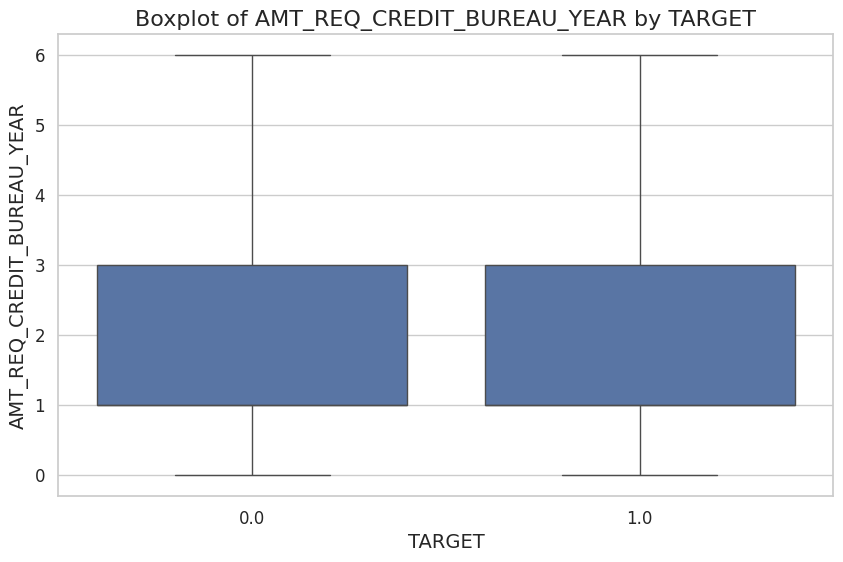

In [ ]:
for col in nominal_cols:
    plt.figure(figsize=(10,6))
    sns.boxplot(x='TARGET',y=col,data= data_encoded)
    plt.title(f'Boxplot of {col} by TARGET')
    plt.show()


In [ ]:
data['DAYS_EMPLOYED'].describe()

,DAYS_EMPLOYED
count,252126.000000
mean,-2384.150631
std,2338.349929
min,-17912.000000
25%,-3175.000000
50%,-1648.000000
75%,-767.000000
max,0.000000


In [ ]:
nominal_cols

['CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'CNT_FAM_MEMBERS',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'TOTALAREA_MODE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [ ]:
from math import nan
k=[0,4,10,11,12,19,20,22]
Xcol=['M']
for i in k:
    print(nominal_cols[i])
    print(i)
    Xcol.append(nominal_cols[i])
    print(Xcol)

Xcol.remove(Xcol[0])
Xcol

CNT_CHILDREN
0
['M', 'CNT_CHILDREN']
AMT_GOODS_PRICE
4
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE']
CNT_FAM_MEMBERS
10
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS']
WEEKDAY_APPR_PROCESS_START
11
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START']
HOUR_APPR_PROCESS_START
12
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START']
OBS_30_CNT_SOCIAL_CIRCLE
19
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE']
OBS_60_CNT_SOCIAL_CIRCLE
20
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']
AMT_REQ_CREDIT_BUREAU_YEAR
22
['M', 'CNT_CHILDREN', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START', 'OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_

['CNT_CHILDREN',
 'AMT_GOODS_PRICE',
 'CNT_FAM_MEMBERS',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [ ]:
df0=data_encoded.drop(Xcol,axis=True)
df0['TARGET']=data['TARGET']


In [ ]:
Xcol

['CNT_CHILDREN',
 'AMT_GOODS_PRICE',
 'CNT_FAM_MEMBERS',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

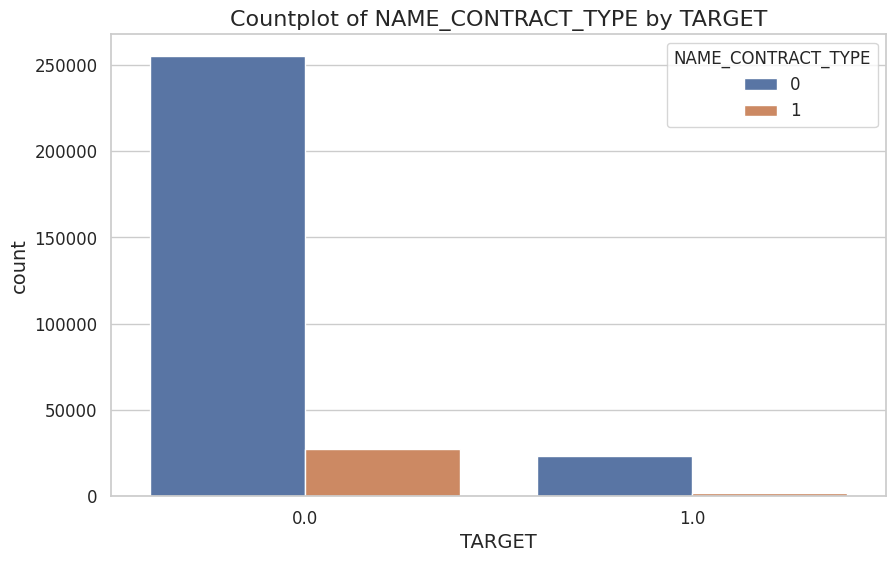

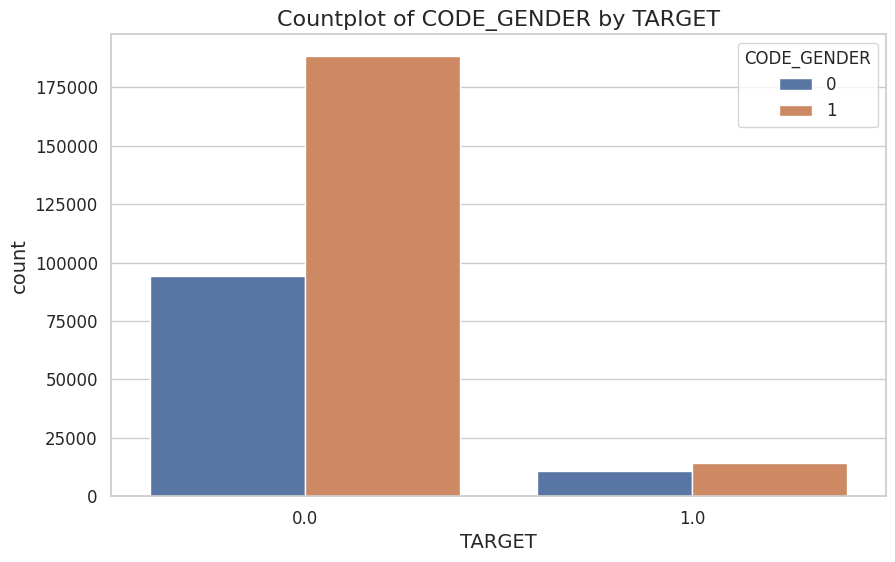

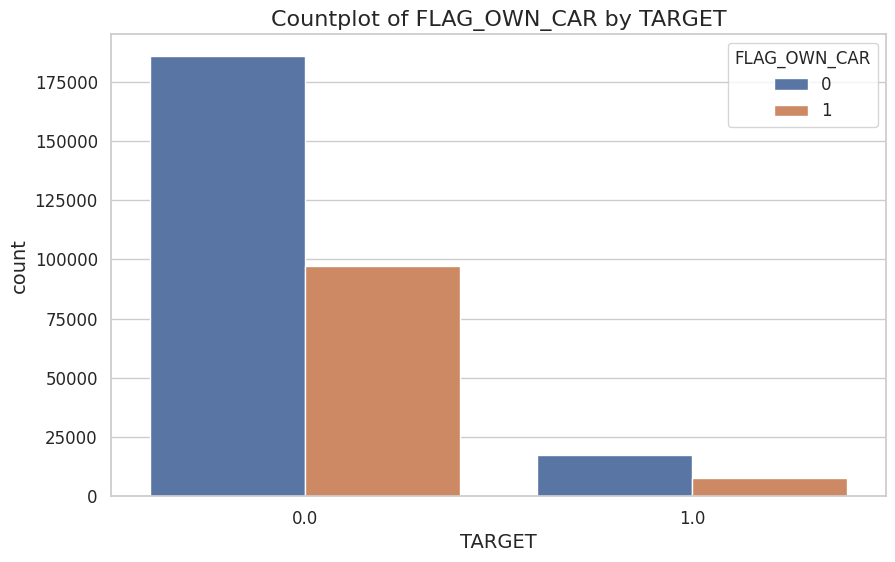

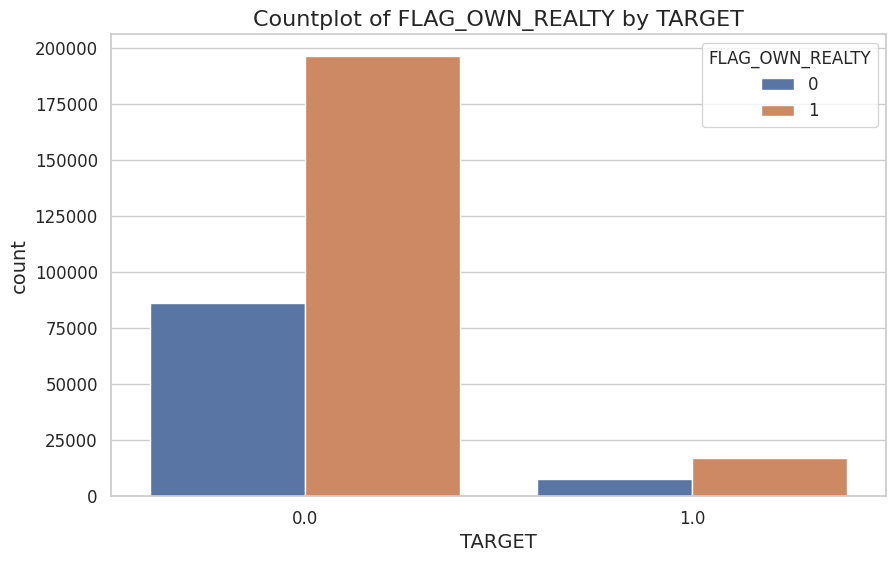

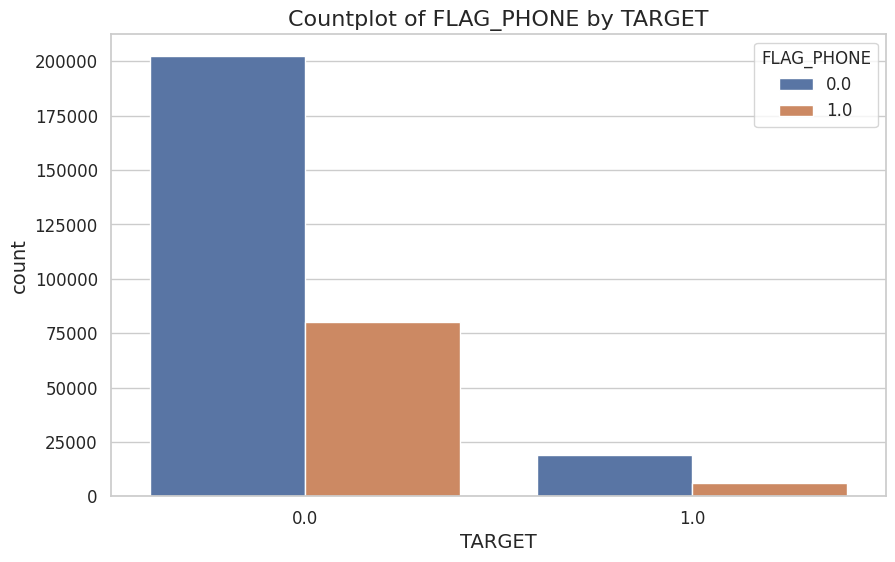

...

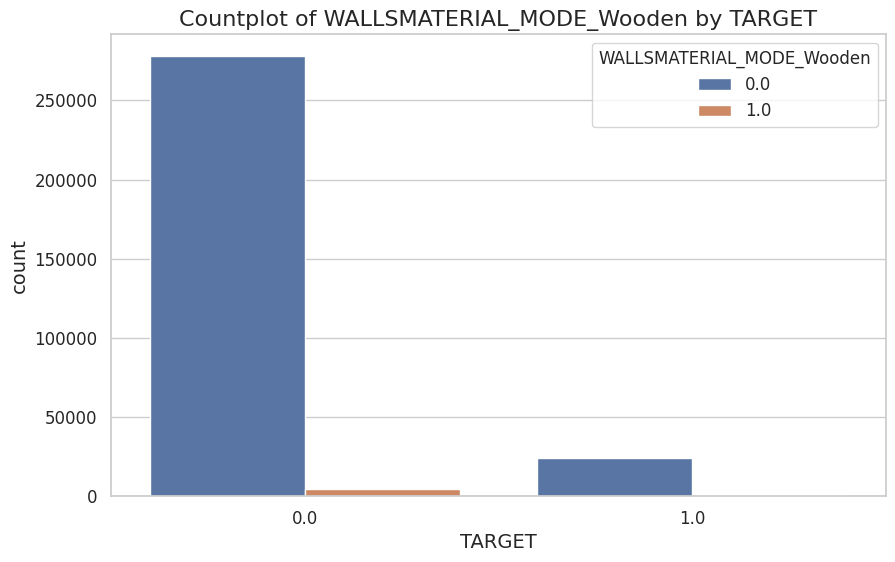

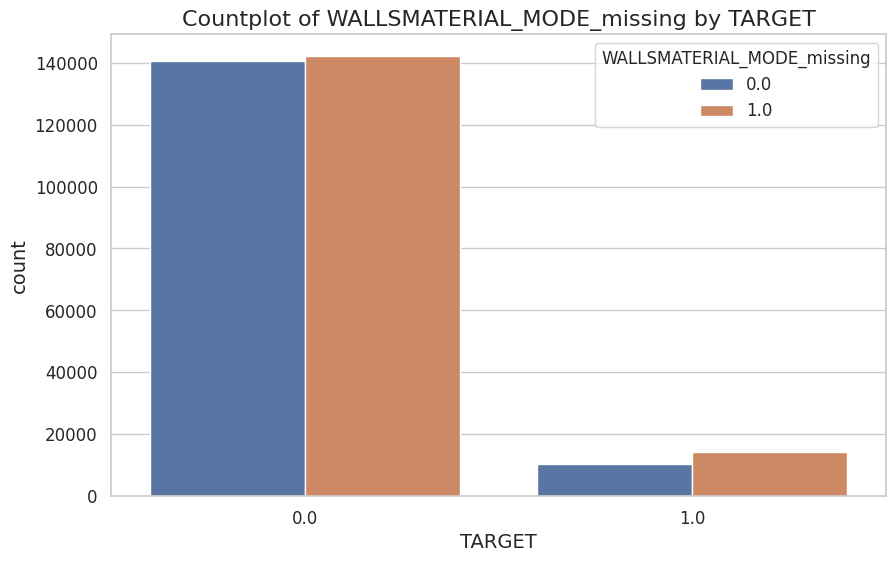

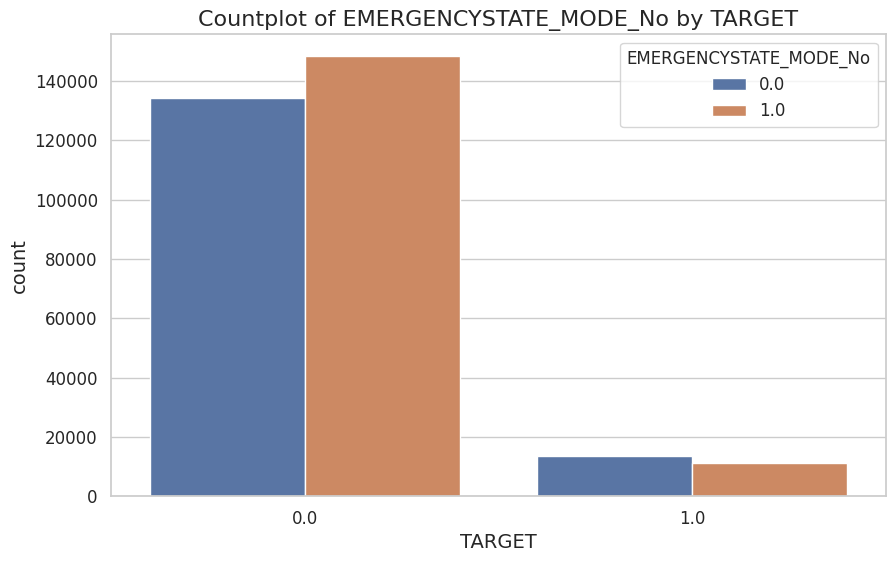

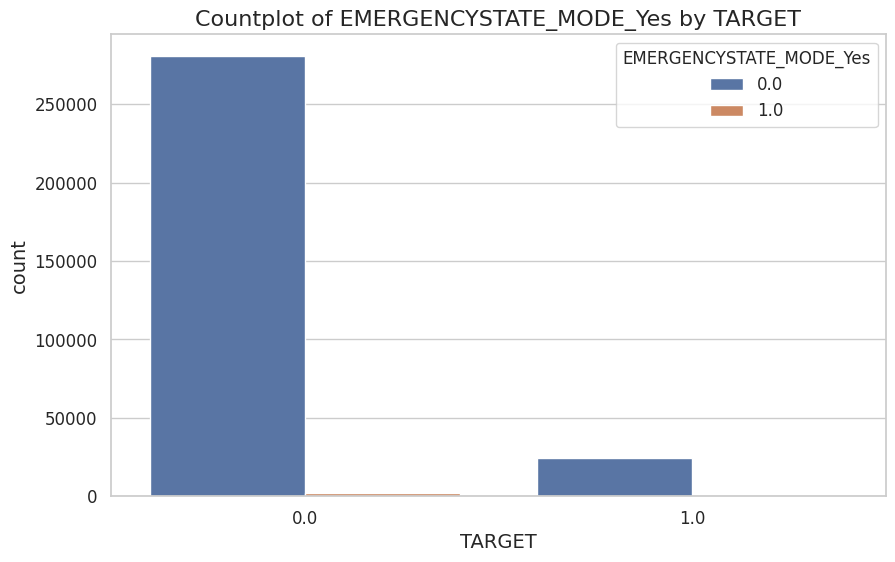

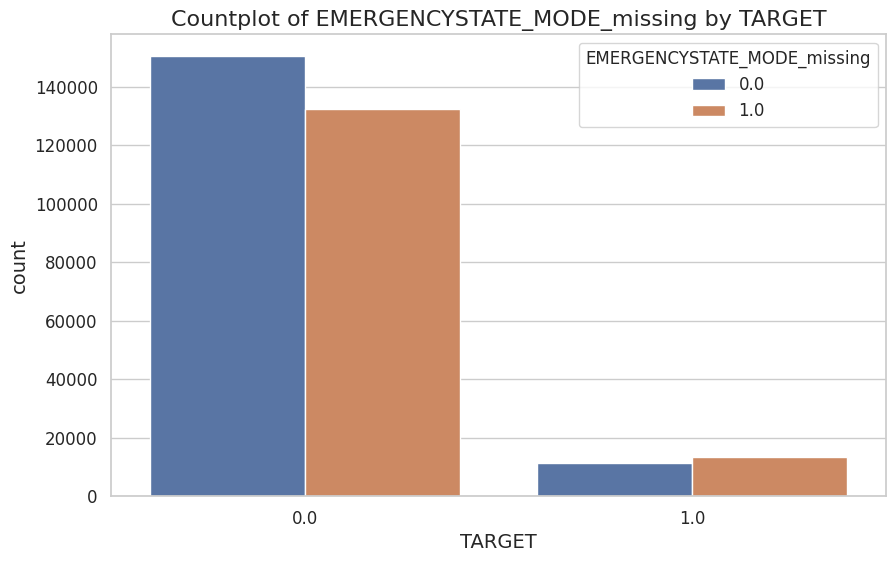

In [ ]:
for col in binary_cols:
    plt.figure(figsize=(10,6))
    sns.countplot(x='TARGET', hue=col, data=data_encoded)
    plt.title(f'Countplot of {col} by TARGET')
    plt.show()

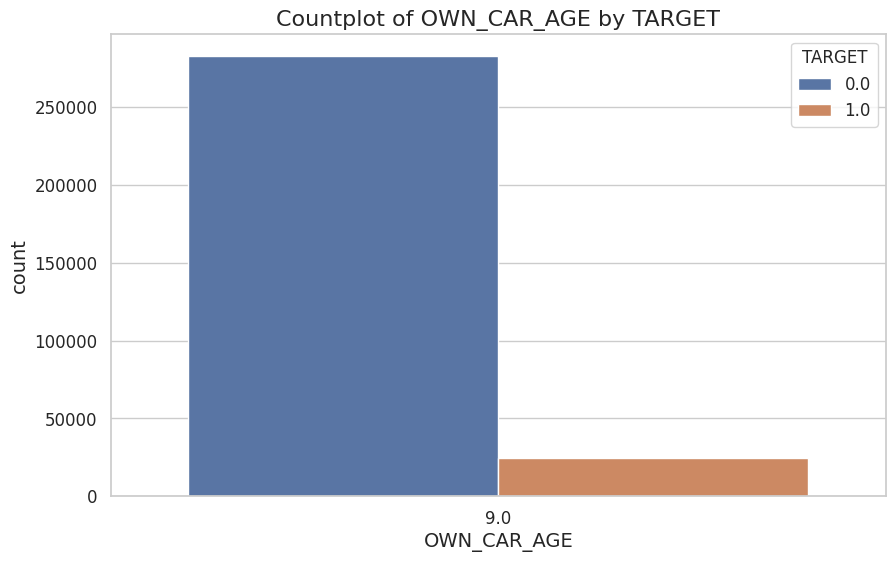

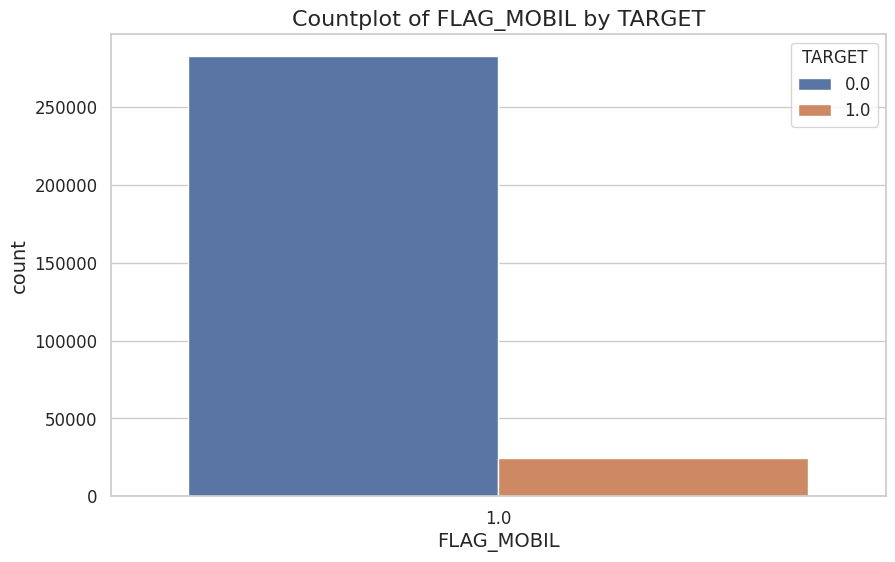

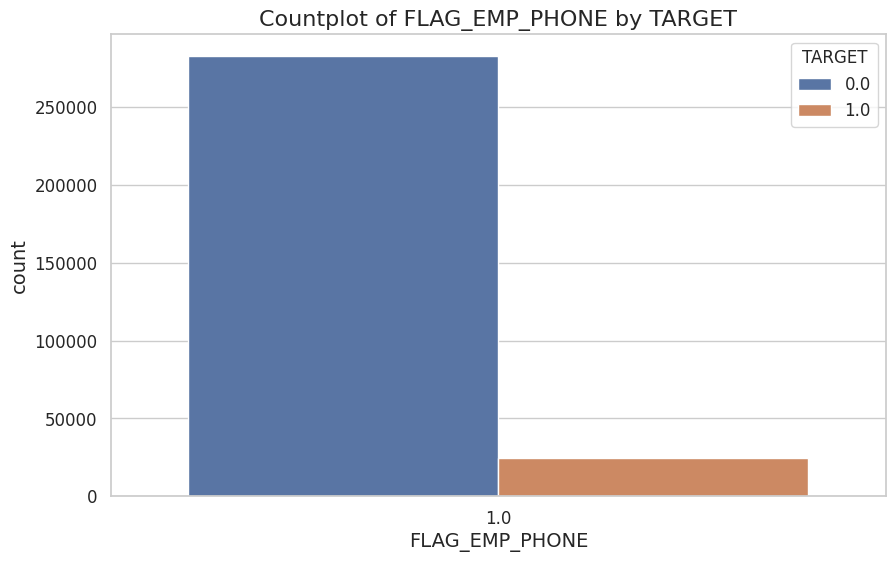

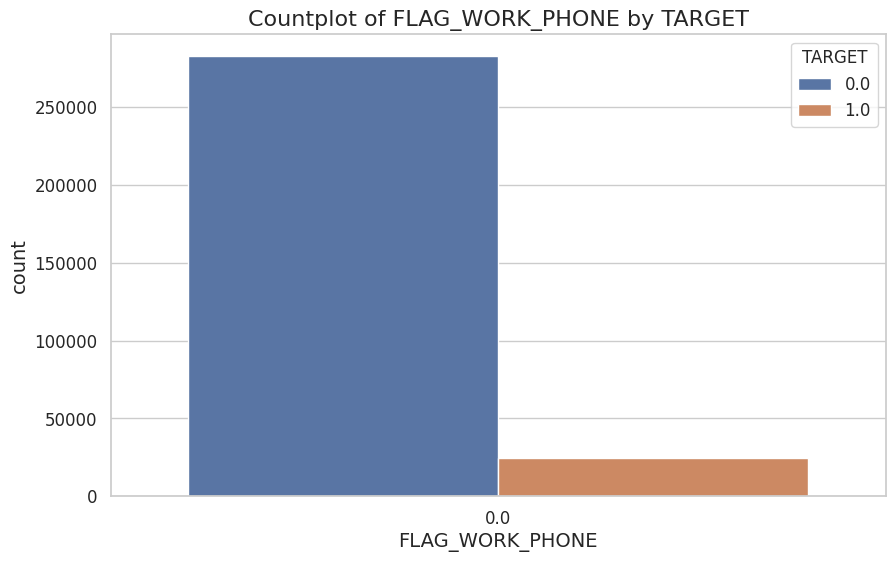

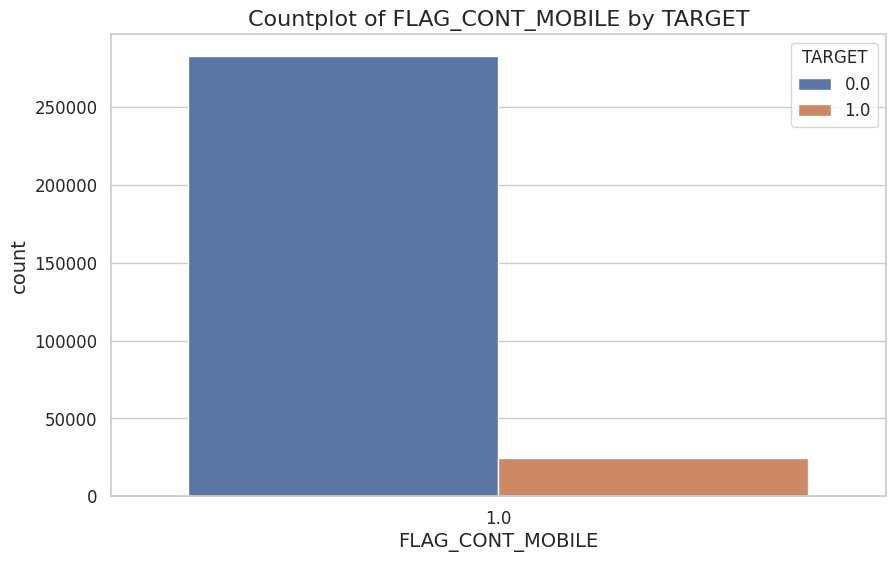

...

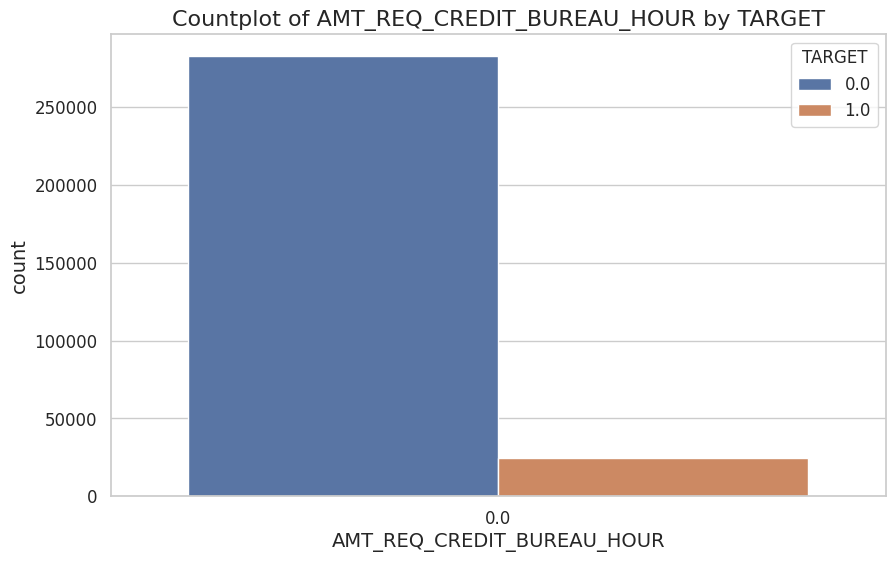

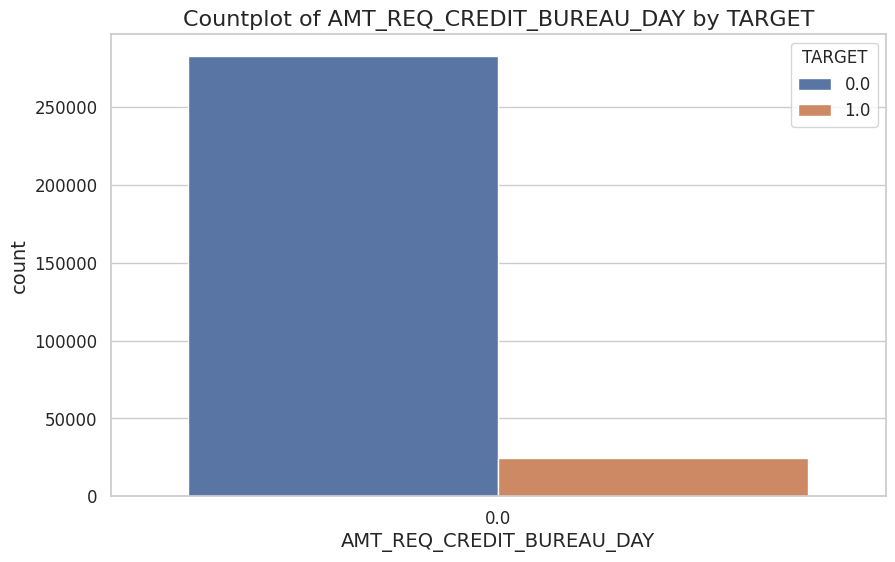

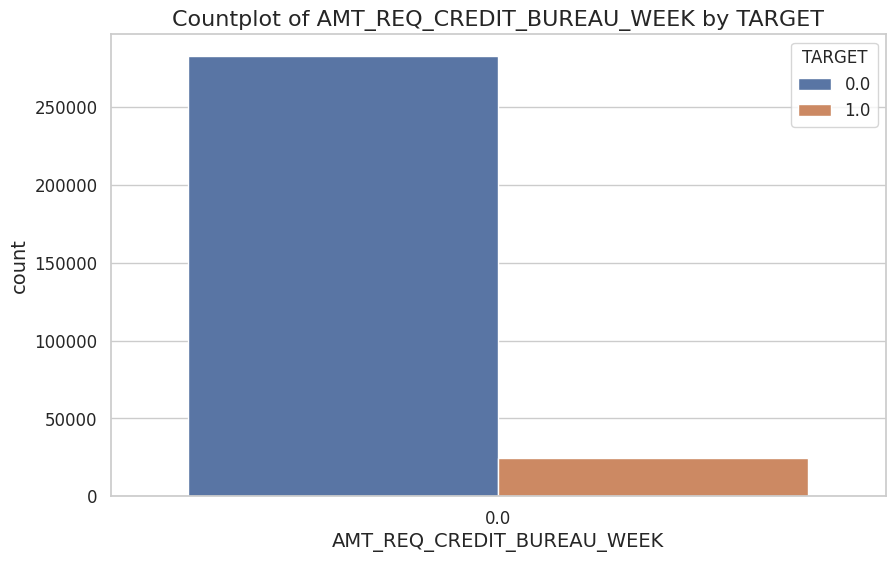

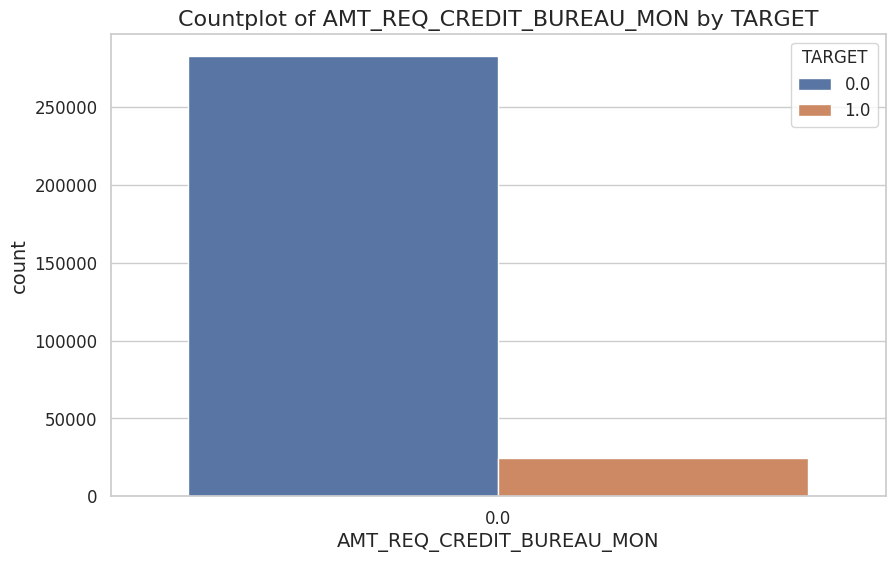

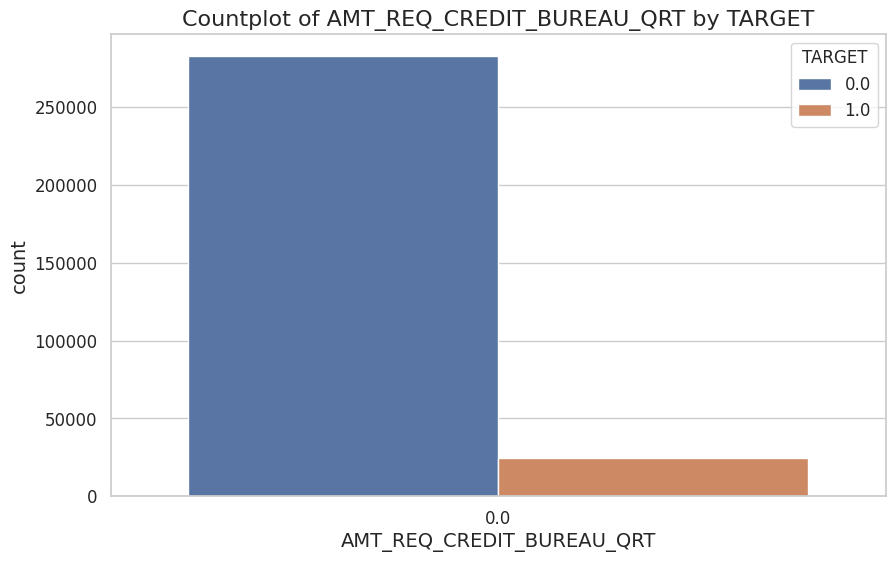

In [ ]:
for col in qui_cols:
    plt.figure(figsize=(10,6))
    sns.countplot(x=col, hue='TARGET', data=data_encoded)
    plt.title(f'Countplot of {col} by TARGET')
    plt.show()

In [ ]:
num_cols_corr=['','','','','']

In [ ]:
# Calcul de la matrice de corrélation absolue
corr_matrix = data_encoded.corr(numeric_only=True)

# Extraire les paires de variables fortement corrélées
high_corr_pairs = (
    corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    .stack()
    .reset_index()
)

high_corr_pairs.columns = ['Variable 1', 'Variable 2', 'Corrélation']
# Garder celles avec une corrélation > 0.90
high_corr_pairs = high_corr_pairs[high_corr_pairs['Corrélation'] > 0.90]

# Affichage
print(high_corr_pairs.sort_values(by='Corrélation', ascending=False))

                          Variable 1                    Variable 2  \
3516        OBS_30_CNT_SOCIAL_CIRCLE      OBS_60_CNT_SOCIAL_CIRCLE   
2971     YEARS_BEGINEXPLUATATION_AVG  YEARS_BEGINEXPLUATATION_MEDI   
934                       AMT_CREDIT               AMT_GOODS_PRICE   
12477         HOUSETYPE_MODE_missing    WALLSMATERIAL_MODE_missing   
12480         HOUSETYPE_MODE_missing   EMERGENCYSTATE_MODE_missing   
12555     WALLSMATERIAL_MODE_missing   EMERGENCYSTATE_MODE_missing   
12465  HOUSETYPE_MODE_block of flats        EMERGENCYSTATE_MODE_No   
3108    YEARS_BEGINEXPLUATATION_MODE  YEARS_BEGINEXPLUATATION_MEDI   
2970     YEARS_BEGINEXPLUATATION_AVG  YEARS_BEGINEXPLUATATION_MODE   

       Corrélation  
3516      0.997863  
2971      0.995131  
934       0.985325  
12477     0.957729  
12480     0.945915  
12555     0.933422  
12465     0.915009  
3108      0.914738  
2970      0.911039  


In [ ]:
clean_df=data_encoded.drop(high_corr_pairs['Variable 2'],axis=True)

In [ ]:
clean_df.duplicated().sum()

np.int64(0)

In [ ]:
clean_df.shape

(307511, 232)

In [ ]:
clean_df['TARGET']=data['TARGET'] # Effectuer un split train/test
features,test_features = train_test_split(clean_df, test_size=0.2, random_state=RANDOM_SEED)


print("Columns in features:", features.columns)
print("Columns in test_features:", test_features.columns)

Columns in features: Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       ...
       'HOUSETYPE_MODE_specific housing', 'HOUSETYPE_MODE_terraced house',
       'WALLSMATERIAL_MODE_Block', 'WALLSMATERIAL_MODE_Mixed',
       'WALLSMATERIAL_MODE_Monolithic', 'WALLSMATERIAL_MODE_Others',
       'WALLSMATERIAL_MODE_Panel', 'WALLSMATERIAL_MODE_Stone, brick',
       'WALLSMATERIAL_MODE_Wooden', 'EMERGENCYSTATE_MODE_Yes'],
      dtype='object', length=232)
Columns in test_features: Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       ...
       'HOUSETYPE_MODE_specific housing', 'HOUSETYPE_MODE_terraced house',
       'WALLSMATERIAL_MODE_Block', 'WALLSMATERIAL_MODE_Mixed',
       'WALLSM

In [ ]:
clean_df.shape

(307511, 232)

In [ ]:
clean_df.head()

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,REGION_POPULATION_RELATIVE,DAYS_BIRTH,...,HOUSETYPE_MODE_specific housing,HOUSETYPE_MODE_terraced house,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_Yes
0,0,0,0,1,0.0,202500.0,406597.5,24700.5,0.018801,-9461.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0,1,0,0,0.0,270000.0,1293502.5,35698.5,0.003541,-16765.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1,0,1,1,0.0,67500.0,135000.0,6750.0,0.010032,-19046.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0,1,0,1,0.0,135000.0,312682.5,29686.5,0.008019,-19005.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0,0,0,1,0.0,121500.0,513000.0,21865.5,0.028663,-19932.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
clean_df['TARGET']

,TARGET
0,1.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
307506,0.0
307507,0.0
307508,0.0
307509,1.0


In [ ]:
clean_df['TARGET'].isna().sum()
clean_df=clean_df.dropna()

In [ ]:
df[numericals_columns]

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,0.0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461.0,-637.0,-3648.0,-2120.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765.0,-1188.0,-1186.0,-291.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046.0,-225.0,-4260.0,-2531.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005.0,-3039.0,-9833.0,-2437.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932.0,-3038.0,-4311.0,-3458.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,0.0,157500.0,254700.0,27558.0,225000.0,0.032561,-9327.0,-236.0,-8456.0,-1982.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
307507,0.0,72000.0,269550.0,12001.5,225000.0,0.025164,-20775.0,3417.5,-4388.0,-4090.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
307508,0.0,153000.0,677664.0,29979.0,585000.0,0.005002,-14966.0,-6466.5,-6737.0,-5150.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
307509,0.0,171000.0,370107.0,20205.0,319500.0,0.005313,-11961.0,-4786.0,-2562.0,-931.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df,coln,colc=encode_features(df[categorical_columns])

In [ ]:
df['TARGET']=data['TARGET']

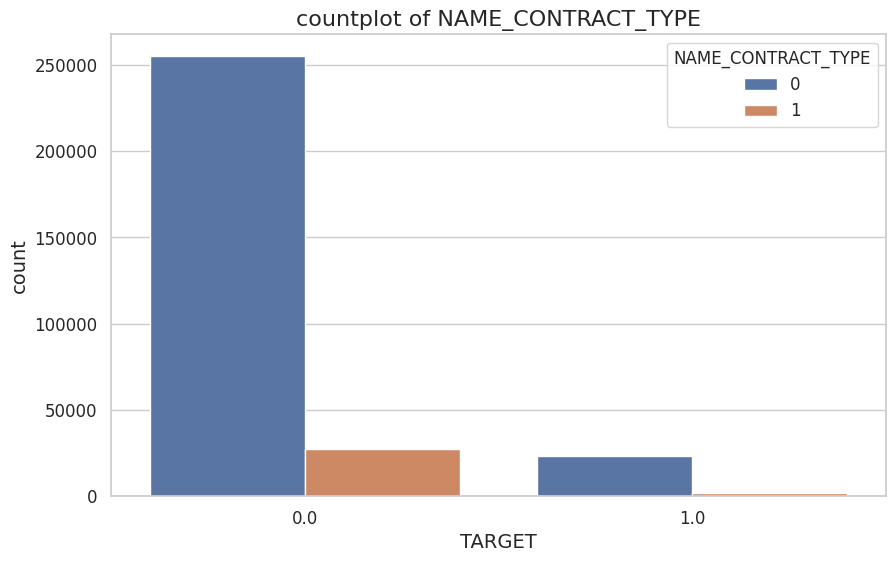

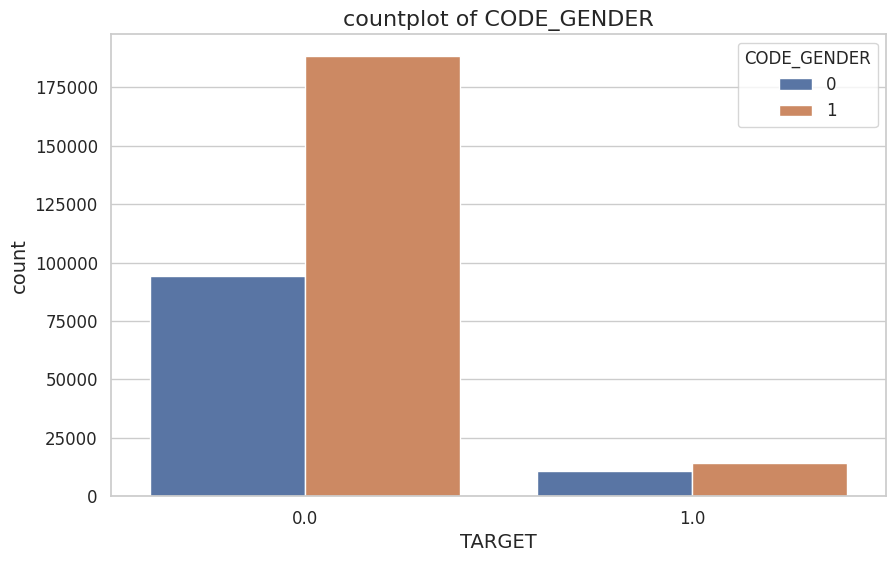

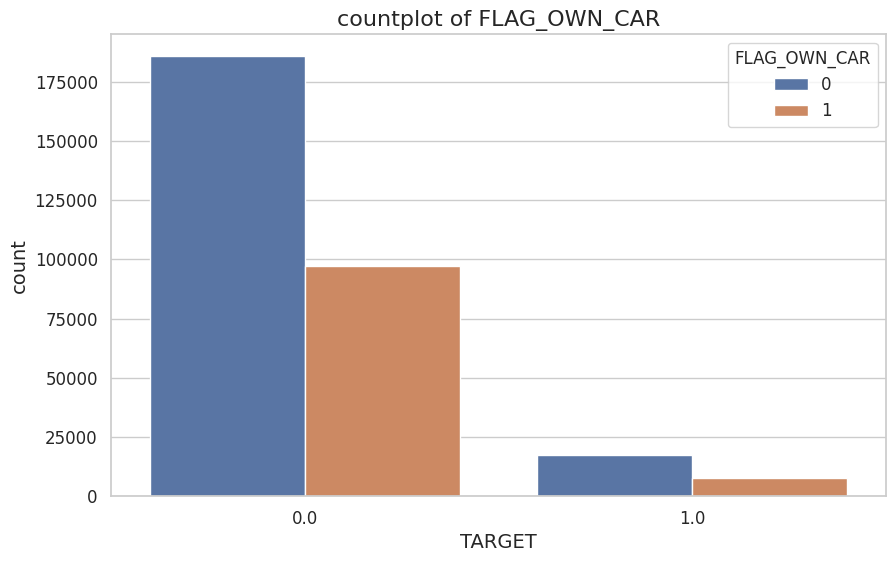

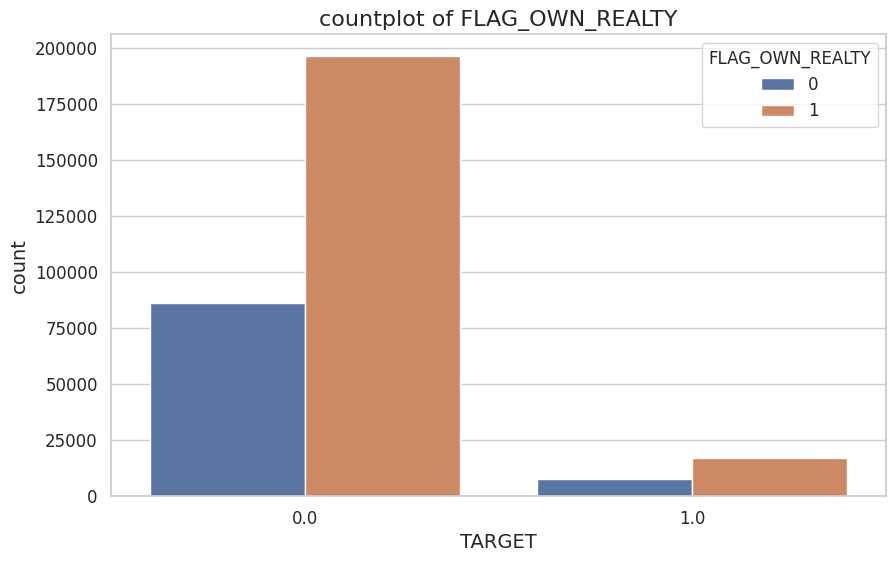

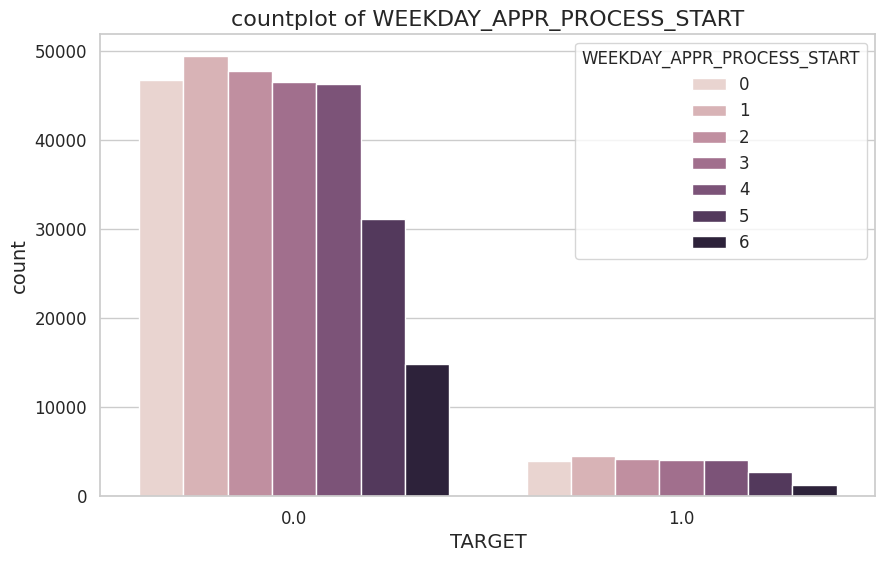

...

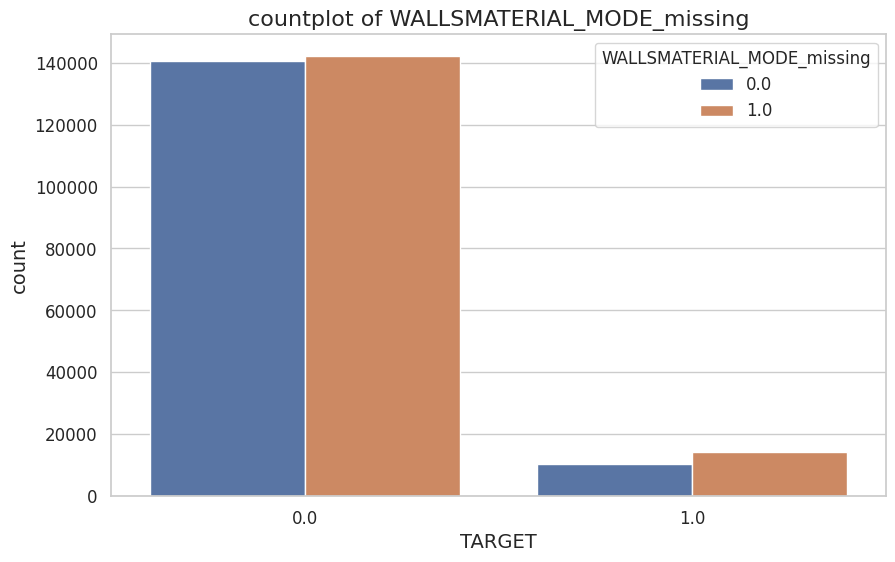

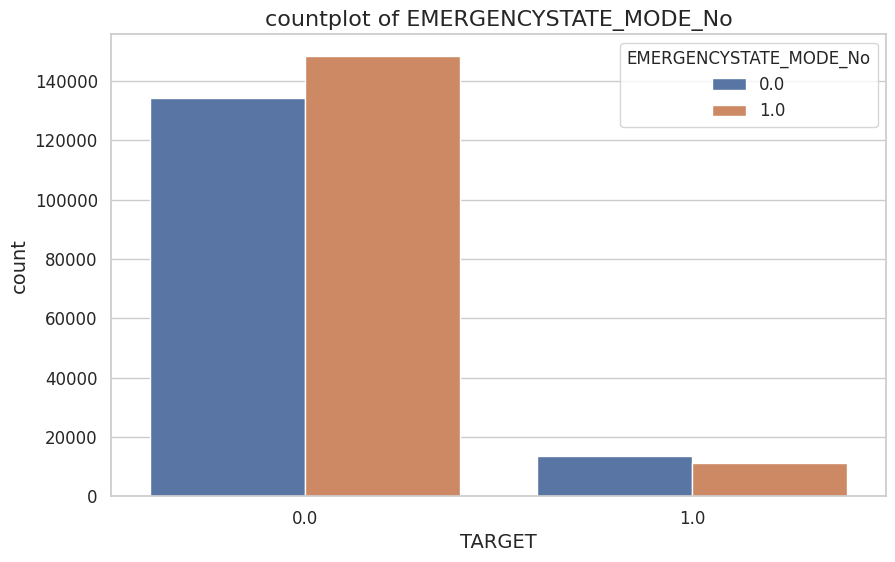

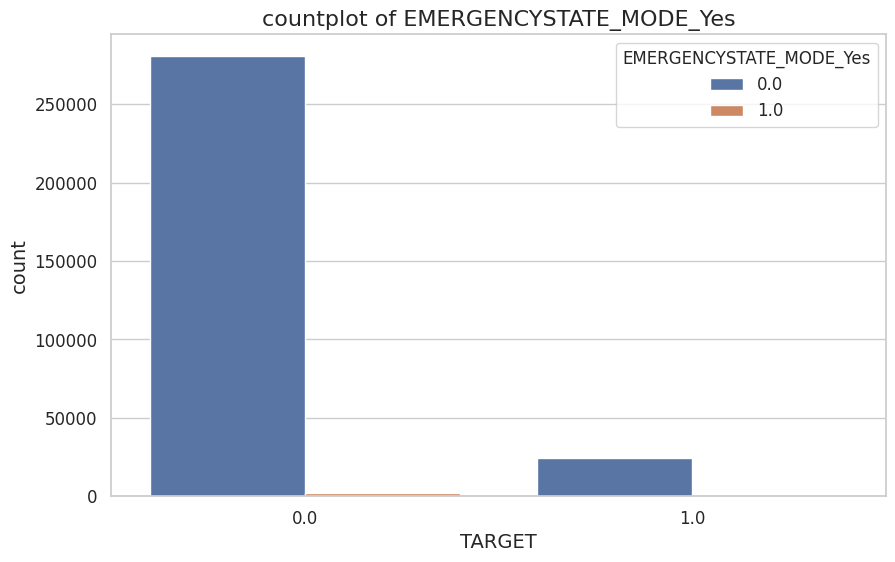

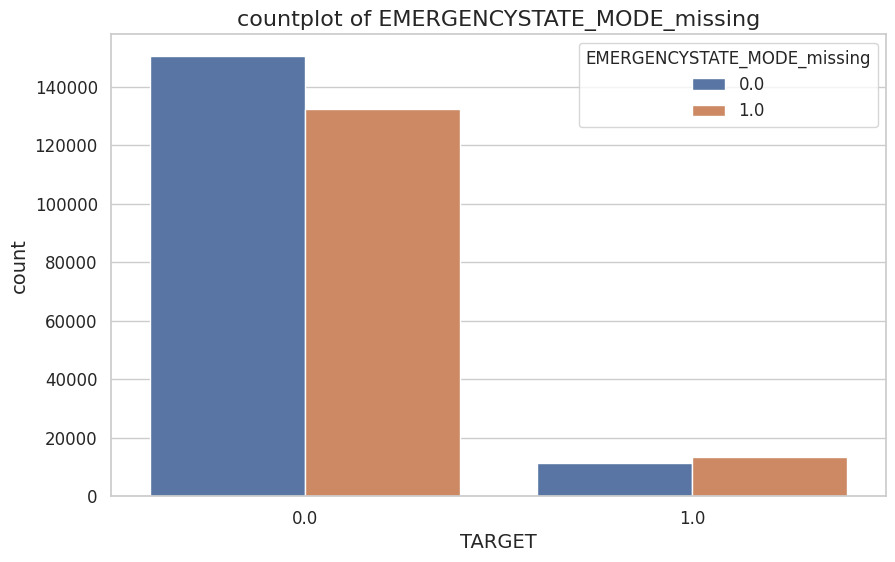

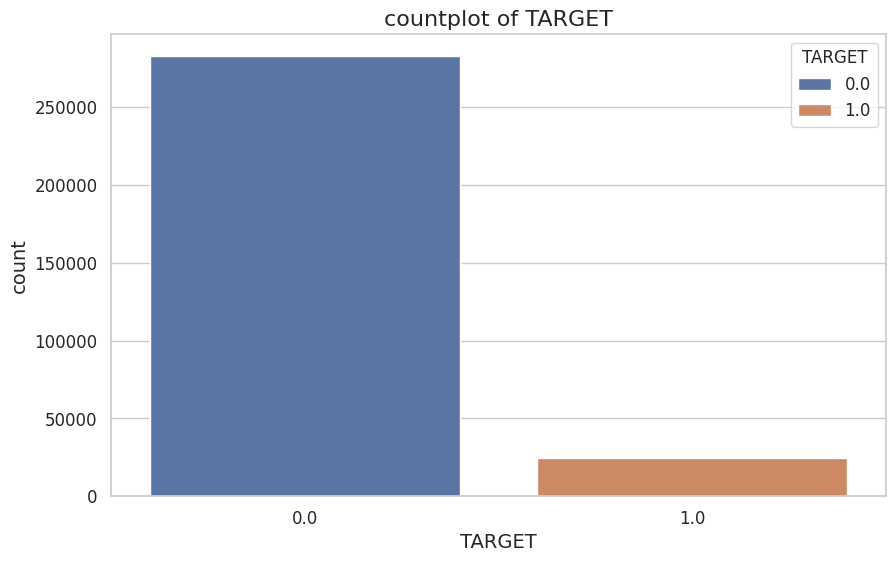

In [ ]:
for col in df.columns:
    plt.figure(figsize=(10,6))
    sns.countplot(x='TARGET',hue=col,data=df)
    plt.title(f'countplot of {col}')
    plt.show()

Taille de l'ensemble d'entraînement (normal uniquement): (226141, 230)
Taille de l'ensemble de test (mix normal/fraude): (81359, 230)
Distribution de la cible dans l'ensemble de test:
0    0.694895
1    0.305105
Name: proportion, dtype: float64

--- 2. Construction et Entraînement de l'Autoencodeur ---


Model: "Autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Input (InputLayer)              │ (None, 230)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Encoder_Layer_1 (Dense)         │ (None, 115)            │        26,565 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Encoder_Dropout_1 (Dropout)     │ (None, 115)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Encoder_Layer_2 (Dense)         │ (None, 57)             │         6,612 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Encoder_Dropout_2 (Dropout)     │ (None, 57)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Bottleneck_Layer (Dense)        │ (None, 28)             │         1,624 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Decoder_Layer_1 (Dense)         │ (None, 57)             │         1,653 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Decoder_Dropout_1 (Dropout)     │ (None, 57)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Decoder_Layer_2 (Dense)         │ (None, 115)            │         6,670 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Decoder_Dropout_2 (Dropout)     │ (None, 115)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Output_Layer (Dense)            │ (None, 230)            │        26,680 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 69,804 (272.67 KB)

 Trainable params: 69,804 (272.67 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - loss: 0.0234 - val_loss: 0.0086
Epoch 2/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0111 - val_loss: 0.0073
Epoch 3/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0100 - val_loss: 0.0067
Epoch 4/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0094 - val_loss: 0.0062
Epoch 5/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - loss: 0.0088 - val_loss: 0.0057
Epoch 6/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0084 - val_loss: 0.0054
Epoch 7/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - loss: 0.0080 - val_loss: 0.0052
Epoch 8/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - loss: 0.0076 - val_loss: 0.0048
Epoch 9/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - loss: 0.0073 - val_loss: 0.0047
Epoch 10/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0071 - val_loss: 0.0045
Epoch 11/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0069 - val_loss: 0.0044
Epoch 12

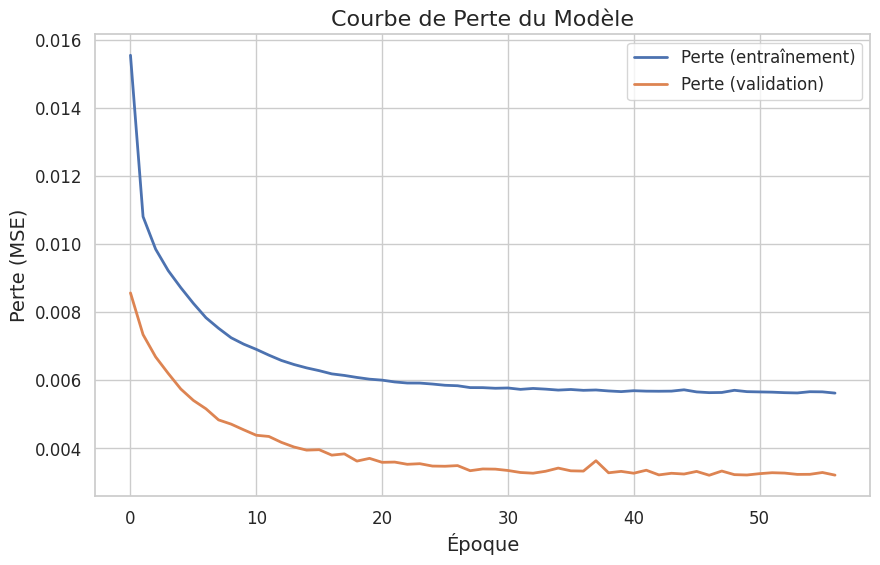


--- 3. Évaluation du Modèle ---
2543/2543 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step


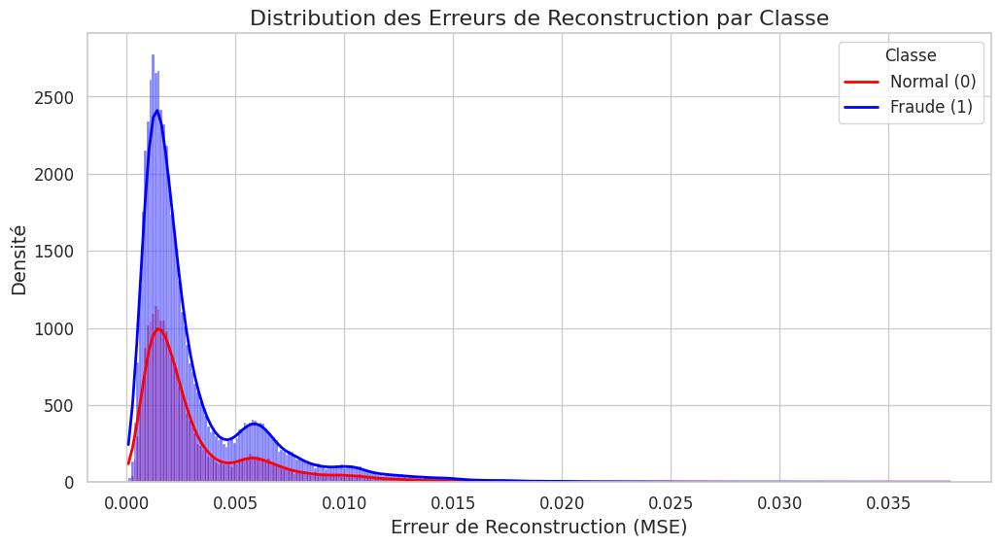

              count      mean       std       min       25%       50%  \
true_class                                                              
0           56536.0  0.003215  0.003124  0.000097  0.001286  0.002001   
1           24823.0  0.003231  0.003064  0.000088  0.001347  0.002086   

                 75%       max  
true_class                      
0           0.003945  0.036608  
1           0.003857  0.037833  

--- Choix du Seuil Optimal ---
Seuil optimal basé sur F1-score max (0.4677): 0.000257

--- Courbe ROC et AUC ---


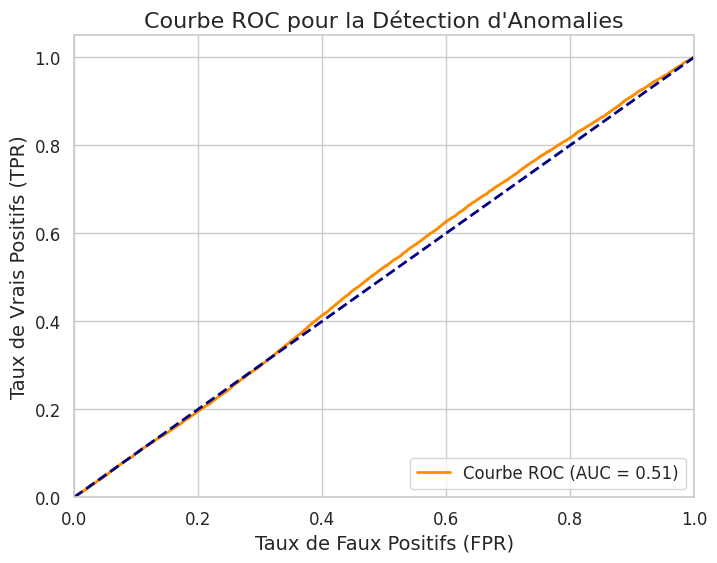

Score AUC: 0.5108

--- Matrice de Confusion et Rapport de Classification ---


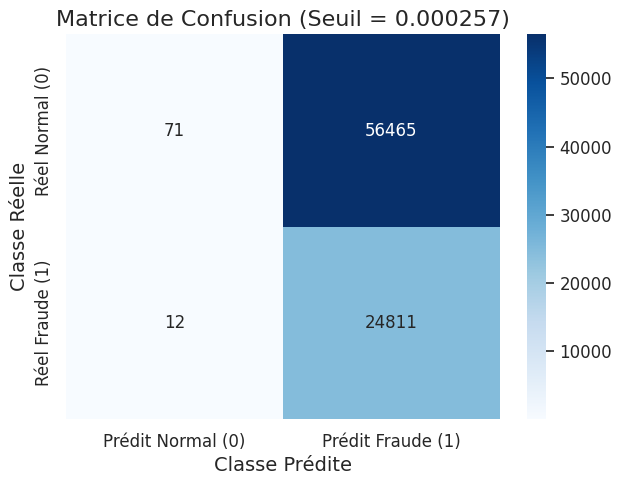


Rapport de Classification:
              precision    recall  f1-score   support

  Normal (0)     0.8554    0.0013    0.0025     56536
  Fraude (1)     0.3053    0.9995    0.4677     24823

    accuracy                         0.3058     81359
   macro avg     0.5803    0.5004    0.2351     81359
weighted avg     0.6876    0.3058    0.1444     81359



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import (
    confusion_matrix,
    classification_report,
    roc_curve,
    auc,
    precision_recall_curve,
    f1_score
)

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Supposons que df0 est votre DataFrame déjà chargé et nettoyé
# Exemple:
# df0 = pd.read_csv('votre_fichier_clean.csv')
# N_FEATURES = 222 # Nombre de variables explicatives
# 'TARGET' = 'TARGET'

# Pour la démonstration, créons un DataFrame factice

FRAUD_PERCENTAGE = 0.05 # 5% de fraude


X = df0.drop('TARGET', axis=1)
y = df0['TARGET']

# Isoler les données normales pour l'entraînement de l'autoencodeur
X_normal_full = X[y == 0]
y_normal_full = y[y == 0] # Non utilisé pour l'entraînement de l'AE, mais pour la cohérence

# Isoler les données de fraude pour le set de test
X_fraud_full = X[y == 1]
y_fraud_full = y[y == 1]

# Diviser les données normales en ensembles d'entraînement et de test
# Une partie des données normales sera dans le set de test pour évaluer
# comment l'autoencodeur reconstruit les données normales non vues.
X_train_normal, X_test_normal, _, _ = train_test_split(
    X_normal_full, y_normal_full, test_size=0.2, random_state=RANDOM_SEED
)

# Créer le set de test final en combinant X_test_normal et toutes les fraudes
X_test = pd.concat([X_test_normal, X_fraud_full], axis=0)
y_test = pd.concat([pd.Series([0]*len(X_test_normal), index=X_test_normal.index),
                    pd.Series([1]*len(X_fraud_full), index=X_fraud_full.index)], axis=0)


# Mélanger le jeu de test
shuffle_indices = np.random.permutation(len(X_test))
X_test = X_test.iloc[shuffle_indices]
y_test = y_test.iloc[shuffle_indices]


print(f"Taille de l'ensemble d'entraînement (normal uniquement): {X_train_normal.shape}")
print(f"Taille de l'ensemble de test (mix normal/fraude): {X_test.shape}")
print(f"Distribution de la cible dans l'ensemble de test:\n{y_test.value_counts(normalize=True)}")

# Normalisation des données
# Utiliser MinMaxScaler pour mettre les données entre 0 et 1, adapté pour l'activation sigmoid en sortie
scaler = MinMaxScaler()
X_train_normal_scaled = scaler.fit_transform(X_train_normal)
X_test_scaled = scaler.transform(X_test) # Important: utiliser transform() seulement sur le test set

# Convertir en DataFrame pour garder les noms de colonnes (optionnel mais peut aider)
X_train_normal_scaled_df = pd.DataFrame(X_train_normal_scaled, columns=X_train_normal.columns, index=X_train_normal.index)
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=X_test.columns, index=X_test.index)


# --- 2. Fit (Construction et Entraînement de l'Autoencodeur) ---
print("\n--- 2. Construction et Entraînement de l'Autoencodeur ---")

INPUT_DIM = X_train_normal_scaled_df.shape[1]
ENCODING_DIM_1 = int(INPUT_DIM / 2) # ex: 111
ENCODING_DIM_2 = int(ENCODING_DIM_1 / 2) # ex: 55
BOTTLENECK_DIM = int(ENCODING_DIM_2 / 2) # ex: 27 (ou un peu plus petit)

# Architecture de l'Autoencodeur
input_layer = Input(shape=(INPUT_DIM,), name="Input")

# Encodeur
encoder = Dense(ENCODING_DIM_1, activation="relu", name="Encoder_Layer_1")(input_layer)
encoder = Dropout(0.1, name="Encoder_Dropout_1")(encoder)
encoder = Dense(ENCODING_DIM_2, activation="relu", name="Encoder_Layer_2")(encoder)
encoder = Dropout(0.1, name="Encoder_Dropout_2")(encoder)
bottleneck = Dense(BOTTLENECK_DIM, activation="relu", name="Bottleneck_Layer")(encoder)

# Décodeur
decoder = Dense(ENCODING_DIM_2, activation="relu", name="Decoder_Layer_1")(bottleneck)
decoder = Dropout(0.1, name="Decoder_Dropout_1")(decoder)
decoder = Dense(ENCODING_DIM_1, activation="relu", name="Decoder_Layer_2")(decoder)
decoder = Dropout(0.1, name="Decoder_Dropout_2")(decoder)
output_layer = Dense(INPUT_DIM, activation="sigmoid", name="Output_Layer")(decoder) # Sigmoid car données normalisées entre 0 et 1

autoencoder = Model(inputs=input_layer, outputs=output_layer, name="Autoencoder")

autoencoder.compile(optimizer="adam", loss="mse") # Mean Squared Error est commun pour la reconstruction

autoencoder.summary()

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, mode='min')

# Entraînement
EPOCHS = 100 # Ajustez selon vos besoins
BATCH_SIZE = 32 # Ajustez selon vos besoins

history = autoencoder.fit(
    X_train_normal_scaled_df, # Entrée
    X_train_normal_scaled_df, # Sortie (objectif de reconstruction)
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    shuffle=True,
    validation_split=0.1, # Utilise 10% des données d'entraînement normales pour la validation
    callbacks=[early_stopping],
    verbose=1
)

# Visualiser la perte d'entraînement et de validation
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Perte (entraînement)')
plt.plot(history.history['val_loss'], label='Perte (validation)')
plt.title('Courbe de Perte du Modèle')
plt.ylabel('Perte (MSE)')
plt.xlabel('Époque')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()

# --- 3. Évaluation ---
print("\n--- 3. Évaluation du Modèle ---")

# Calculer les erreurs de reconstruction sur l'ensemble de test
X_test_reconstructed = autoencoder.predict(X_test_scaled_df)
mse_test = np.mean(np.power(X_test_scaled_df - X_test_reconstructed, 2), axis=1)

# Créer un DataFrame pour l'analyse des erreurs
error_df = pd.DataFrame({'reconstruction_error': mse_test, 'true_class': y_test})

# Visualiser la distribution des erreurs de reconstruction
plt.figure(figsize=(12, 6))
sns.histplot(data=error_df, x='reconstruction_error', hue='true_class', kde=True, palette={0: 'blue', 1: 'red'})
plt.title('Distribution des Erreurs de Reconstruction par Classe')
plt.xlabel('Erreur de Reconstruction (MSE)')
plt.ylabel('Densité')
plt.legend(title='Classe', labels=['Normal (0)', 'Fraude (1)'])
plt.grid(True)
plt.show()

print(error_df.groupby('true_class')['reconstruction_error'].describe())

# --- Choix du Seuil ---
print("\n--- Choix du Seuil Optimal ---")
# Utiliser la courbe Précision-Rappel pour trouver un bon seuil
# car c'est souvent plus informatif pour les données déséquilibrées
precision, recall, thresholds_pr = precision_recall_curve(y_test, mse_test)

# Calculer le F1-score pour chaque seuil
# (on ignore le dernier seuil qui correspond à un rappel de 0 et une précision de 1, ou vice-versa)
f1_scores = (2 * precision * recall) / (precision + recall)
f1_scores = f1_scores[:-1] # Exclure le dernier score NaN/Inf si division par zéro
thresholds_pr_valid = thresholds_pr[:len(f1_scores)]


# Trouver le seuil qui maximise le F1-score pour la classe de fraude
if len(f1_scores) > 0:
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold_f1 = thresholds_pr_valid[optimal_idx]
    print(f"Seuil optimal basé sur F1-score max ({f1_scores[optimal_idx]:.4f}): {optimal_threshold_f1:.6f}")
else:
    print("Impossible de calculer les F1-scores valides, utilisation d'un seuil par défaut (percentile)")
    optimal_threshold_f1 = np.percentile(mse_test[y_test==0], 95) # Seuil basé sur les 95% des erreurs des normaux

# Un autre seuil commun : basé sur un percentile des erreurs de reconstruction des données normales (si disponibles dans le test set ou via un set de validation)
# mse_normal_in_test = error_df[error_df['true_class'] == 0]['reconstruction_error']
# if not mse_normal_in_test.empty:
#     threshold_percentile = np.percentile(mse_normal_in_test, 99) # Par exemple, 99ème percentile
#     print(f"Seuil basé sur le 99ème percentile des erreurs normales dans le test: {threshold_percentile:.6f}")
# else:
#     print("Pas de données normales dans le test pour calculer le seuil par percentile, utilisation du seuil F1.")
#     threshold_percentile = optimal_threshold_f1

# Utilisons le seuil optimisé par F1-score
final_threshold = optimal_threshold_f1
y_pred_anomaly = (mse_test > final_threshold).astype(int)


# --- Évaluation avec Courbe ROC et AUC ---
print("\n--- Courbe ROC et AUC ---")
fpr, tpr, thresholds_roc = roc_curve(y_test, mse_test) # mse_test sont les scores des anomalies
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Courbe ROC (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taux de Faux Positifs (FPR)')
plt.ylabel('Taux de Vrais Positifs (TPR)')
plt.title('Courbe ROC pour la Détection d\'Anomalies')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()
print(f"Score AUC: {roc_auc:.4f}")


# --- Matrice de Confusion et Rapport de Classification ("Matrice de Précision") ---
print("\n--- Matrice de Confusion et Rapport de Classification ---")
cm = confusion_matrix(y_test, y_pred_anomaly)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=['Prédit Normal (0)', 'Prédit Fraude (1)'],
            yticklabels=['Réel Normal (0)', 'Réel Fraude (1)'])
plt.title(f'Matrice de Confusion (Seuil = {final_threshold:.6f})')
plt.ylabel('Classe Réelle')
plt.xlabel('Classe Prédite')
plt.show()

print("\nRapport de Classification:")
# Note: target_names doit correspondre aux classes 0 et 1
print(classification_report(y_test, y_pred_anomaly, target_names=['Normal (0)', 'Fraude (1)'], digits=4))

Train normal shape: (226141, 231)
Test mixte shape: (81359, 231)
0    0.694895
1    0.305105
Name: proportion, dtype: float64


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 231)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 115)            │        26,680 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 115)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 57)             │         6,612 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 57)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 28)             │         1,624 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 57)             │         1,653 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 57)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 115)            │         6,670 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 115)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 231)            │        26,796 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 70,035 (273.57 KB)

 Trainable params: 70,035 (273.57 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - loss: 0.0240 - val_loss: 0.0096
Epoch 2/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0122 - val_loss: 0.0085
Epoch 3/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0111 - val_loss: 0.0078
Epoch 4/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0104 - val_loss: 0.0071
Epoch 5/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0098 - val_loss: 0.0066
Epoch 6/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 43s 5ms/step - loss: 0.0092 - val_loss: 0.0062
Epoch 7/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 40s 4ms/step - loss: 0.0088 - val_loss: 0.0059
Epoch 8/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0084 - val_loss: 0.0058
Epoch 9/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 41s 4ms/step - loss: 0.0081 - val_loss: 0.0056
Epoch 10/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0080 - val_loss: 0.0054
Epoch 11/100
6361/6361 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - loss: 0.0078 - val_loss: 0.0053
Epoch 12

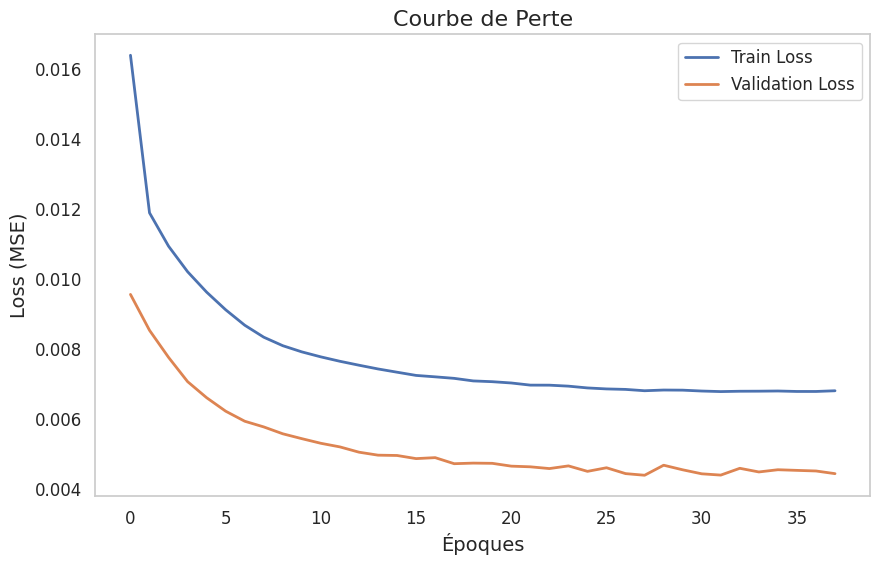

2543/2543 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step


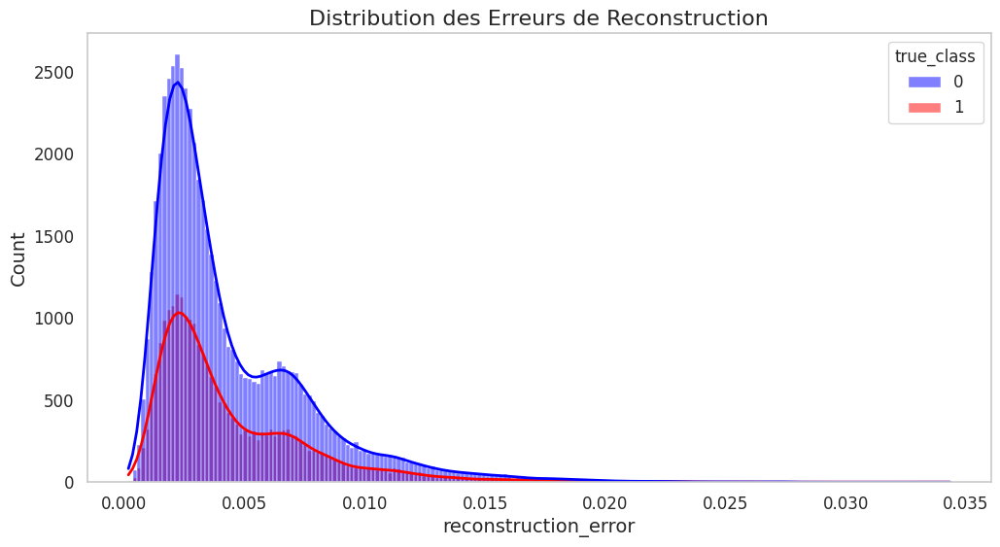

Seuil optimal (F1 max = 0.4676): 0.000441

Classification Report:
               precision    recall  f1-score   support

           0       0.75      0.00      0.00     56536
           1       0.31      1.00      0.47     24823

    accuracy                           0.31     81359
   macro avg       0.53      0.50      0.23     81359
weighted avg       0.61      0.31      0.14     81359



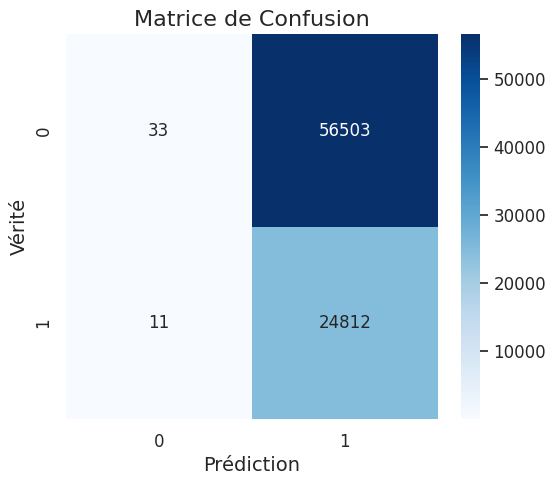

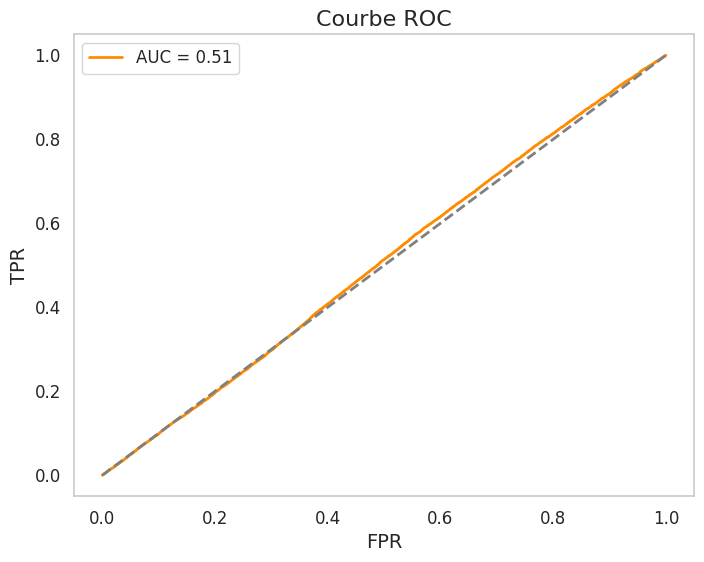

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import (
    confusion_matrix, classification_report,
    roc_curve, auc, precision_recall_curve, f1_score
)

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import joblib

# -----------------------------
# 1. Chargement des données
# -----------------------------
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

# ⚠️ À adapter à ton propre fichier ou pipeline
try:
    clean_df
except NameError:
    raise ValueError("Le DataFrame 'clean_df' n'est pas défini. Charge-le avant d'exécuter ce script.")

X = clean_df.drop('TARGET', axis=1)
y = clean_df['TARGET']

# -----------------------------
# 2. Séparation normal / fraude
# -----------------------------
X_normal = X[y == 0]
X_fraud = X[y == 1]

X_train_normal, X_test_normal = train_test_split(X_normal, test_size=0.2, random_state=RANDOM_SEED)
X_test = pd.concat([X_test_normal, X_fraud], axis=0)
y_test = pd.Series([0]*len(X_test_normal) + [1]*len(X_fraud), index=X_test.index)

# Mélange
shuffled_indices = np.random.permutation(len(X_test))
X_test = X_test.iloc[shuffled_indices]
y_test = y_test.iloc[shuffled_indices]

print(f"Train normal shape: {X_train_normal.shape}")
print(f"Test mixte shape: {X_test.shape}")
print(y_test.value_counts(normalize=True))

# -----------------------------
# 3. Normalisation
# -----------------------------
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_normal)
X_test_scaled = scaler.transform(X_test)

# Facultatif : sauvegarder le scaler
joblib.dump(scaler, 'scaler.pkl')

# -----------------------------
# 4. Construction Autoencodeur
# -----------------------------
input_dim = X_train_scaled.shape[1]
encoding_dim_1 = input_dim // 2
encoding_dim_2 = encoding_dim_1 // 2
bottleneck_dim = encoding_dim_2 // 2

input_layer = Input(shape=(input_dim,))
x = Dense(encoding_dim_1, activation='relu')(input_layer)
x = Dropout(0.1)(x)
x = Dense(encoding_dim_2, activation='relu')(x)
x = Dropout(0.1)(x)
bottleneck = Dense(bottleneck_dim, activation='relu')(x)
x = Dense(encoding_dim_2, activation='relu')(bottleneck)
x = Dropout(0.1)(x)
x = Dense(encoding_dim_1, activation='relu')(x)
x = Dropout(0.1)(x)
output_layer = Dense(input_dim, activation='sigmoid')(x)

autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer='adam', loss='mse')
autoencoder.summary()

# -----------------------------
# 5. Entraînement
# -----------------------------
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = autoencoder.fit(
    X_train_scaled, X_train_scaled,
    epochs=100,
    batch_size=32,
    validation_split=0.1,
    shuffle=True,
    callbacks=[early_stop],
    verbose=1
)

# Courbe de perte
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title("Courbe de Perte")
plt.xlabel("Époques")
plt.ylabel("Loss (MSE)")
plt.grid()
plt.show()

# -----------------------------
# 6. Évaluation
# -----------------------------
X_test_reconstructed = autoencoder.predict(X_test_scaled)
mse_test = np.mean(np.square(X_test_scaled - X_test_reconstructed), axis=1)

error_df = pd.DataFrame({'reconstruction_error': mse_test, 'true_class': y_test})

# Distribution des erreurs
plt.figure(figsize=(12, 6))
sns.histplot(data=error_df, x='reconstruction_error', hue='true_class', kde=True, palette={0: 'blue', 1: 'red'})
plt.title("Distribution des Erreurs de Reconstruction")
plt.grid()
plt.show()

# -----------------------------
# 7. Choix du seuil optimal
# -----------------------------
precision, recall, thresholds = precision_recall_curve(y_test, mse_test)
f1_scores = 2 * precision * recall / (precision + recall + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]

print(f"Seuil optimal (F1 max = {f1_scores[best_idx]:.4f}): {best_threshold:.6f}")

# -----------------------------
# 8. Prédictions finales
# -----------------------------
y_pred = (mse_test > best_threshold).astype(int)

# Rapport de classification
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel("Prédiction")
plt.ylabel("Vérité")
plt.title("Matrice de Confusion")
plt.show()

# Courbe ROC
fpr, tpr, _ = roc_curve(y_test, mse_test)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}", color='darkorange')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from sklearn.ensemble import RandomForestClassifier
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
import tensorflow as tf

# 1. Données
df = clean_df.copy()
X = df.drop(columns=['TARGET'])
y = df['TARGET']

# 2. Standardisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 3. Split
X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.3, stratify=y, random_state=42
)

# 4. Architecture de l'autoencoder
input_dim = X_train.shape[1]
latent_dim = 50  # dimension compressée à évaluer

input_layer = Input(shape=(input_dim,))
encoded = Dense(128, activation='relu')(input_layer)
encoded = Dense(latent_dim, activation='relu')(encoded)  # couche latente
decoded = Dense(128, activation='relu')(encoded)
decoded = Dense(input_dim, activation='linear')(decoded)

autoencoder = Model(inputs=input_layer, outputs=decoded)
encoder = Model(inputs=input_layer, outputs=encoded)

autoencoder.compile(optimizer='adam', loss='mse')

# 5. Entraînement de l'autoencoder
autoencoder.fit(X_train, X_train,
                epochs=20,
                batch_size=256,
                shuffle=True,
                validation_data=(X_test, X_test),
                verbose=1)

# 6. Compression des données
X_train_encoded = encoder.predict(X_train)
X_test_encoded = encoder.predict(X_test)

# 7. Classification uniquement sur les embeddings
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train_encoded, y_train)

y_pred = clf.predict(X_test_encoded)

# 8. Évaluation
print("\n🎯 Évaluation sur les données compressées :")
print(classification_report(y_test, y_pred))


Epoch 1/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 9s 9ms/step - loss: 0.4314 - val_loss: 0.1738
Epoch 2/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.1519 - val_loss: 0.1213
Epoch 3/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step - loss: 0.1110 - val_loss: 0.1023
Epoch 4/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0949 - val_loss: 0.0922
Epoch 5/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.0853 - val_loss: 0.0844
Epoch 6/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0779 - val_loss: 0.0776
Epoch 7/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.0711 - val_loss: 0.0728
Epoch 8/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.0678 - val_loss: 0.0682
Epoch 9/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.0638 - val_loss: 0.0628
Epoch 10/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 0.0603 - val_loss: 0.0587
Epoch 11/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step - loss: 0.0578 - val_loss: 0.0559
Epoch 12/20
841/841 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
import lightgbm as lgb

# === Étape 1 : Préparation des données ===
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.3, stratify=y, random_state=42
)
encoding_dim=16
input_dim = X_train.shape[1]
# === Étape 2 : Construction de l’autoencodeur ===
input_layer = Input(shape=(input_dim,))
encoded = Dense(64, activation='relu')(input_layer)
encoded = Dense(32, activation='relu')(encoded)
encoded = Dense(encoding_dim, activation='relu')(encoded)

decoded = Dense(64, activation='relu')(encoded)
decoded = Dense(input_dim, activation='linear')(decoded)
encoded = Dense(32, activation='relu')(decoded)
autoencoder = Model(inputs=input_layer, outputs=decoded)
encoder = Model(inputs=input_layer, outputs=encoded)

autoencoder.compile(optimizer='adam', loss='mse')

# === Étape 3 : Entraînement de l’autoencodeur ===
autoencoder.fit(X_train, X_train,
                epochs=30,
                batch_size=256,
                shuffle=True,
                validation_data=(X_test, X_test),
                verbose=1)

# === Étape 4 : Compression des données ===
X_train_encoded = encoder.predict(X_train)
X_test_encoded = encoder.predict(X_test)

# === Étape 5 : Entraînement du classifieur LightGBM ===
clf = lgb.LGBMClassifier(n_estimators=100, random_state=42)
clf.fit(X_train_encoded, y_train)

y_pred = clf.predict(X_test_encoded)

# === Étape 6 : Évaluation ===
print("\n🎯 Rapport de classification (Autoencoder + LightGBM) :")
print(classification_report(y_test, y_pred))


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense

# ----------------------------
# 1. Préparation des données
# ----------------------------

# Suppose que tu as déjà chargé et nettoyé ta base dans `clean_df`
df = clean_df.copy()
df['TARGET'] = df['TARGET'].astype(int)

# Séparer fraudes / normales
df_fraud = df[df['TARGET'] == 1]
df_normal = df[df['TARGET'] == 0]

# Sous-échantillonner 20 % des normales
df_normal_down = resample(df_normal,
                          replace=False,
                          n_samples=int(len(df_normal) * 0.2),
                          random_state=42)

# Fusionner avec les fraudes
df_balanced = pd.concat([df_fraud, df_normal_down])

# Séparer X / y
X = df_balanced.drop(columns=['TARGET'])
y = df_balanced['TARGET']

# Encoder et scaler
X_encoded = encode_features(preprocess_data(X))
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_encoded)

# Appliquer SMOTE
sm = SMOTE(random_state=42)
X_resampled, y_resampled = sm.fit_resample(X_scaled, y)

# ----------------------------
# 2. Construction de l’Autoencoder
# ----------------------------

input_dim = X_resampled.shape[1]
encoding_dim =8
# Choisir une dimension latente raisonnable

input_layer = Input(shape=(input_dim,))
encoded = Dense(16, activation="relu")(input_layer)
encoded = Dense(encoding_dim, activation="relu")(encoded)

decoded = Dense(16, activation='relu')(encoded)
decoded = Dense(input_dim, activation='linear')(decoded)

autoencoder = Model(inputs=input_layer, outputs=decoded)
autoencoder.compile(optimizer='adam', loss='mse')

# ----------------------------
# 3. Entraînement sur données "non frauduleuses"
# ----------------------------

X_resampled_normal = X_resampled[y_resampled == 0]
autoencoder.fit(X_resampled_normal, X_resampled_normal,
                epochs=20, batch_size=256,
                shuffle=True, verbose=1)

# ----------------------------
# 4. Test du modèle sur la base originale
# ----------------------------

X_test = clean_df.drop(columns=['TARGET'])
y_test = clean_df['TARGET']

X_test = encode_features(preprocess_data(X_test))
X_test_scaled = scaler.transform(X_test)

X_pred = autoencoder.predict(X_test_scaled)
mse = np.mean(np.power(X_test_scaled - X_pred, 2), axis=1)

# Définir un seuil (à ajuster)
threshold = np.percentile(mse, 95)
y_pred = (mse > threshold).astype(int)

# ----------------------------
# 5. Rapport de classification
# ----------------------------

print(classification_report(y_test, y_pred))


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from imblearn.over_sampling import SMOTE
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense

# --- Étape 1 : Préparation des données ---
df = clean_df.copy()
target_col = 'TARGET'  # adapte selon ton dataset
X = df.drop(columns=[target_col])
y = df[target_col]

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split train/test
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, stratify=y, random_state=42)

# --- Étape 2 : Autoencoder entraîné uniquement sur les données normales ---
X_train_normals = X_train[y_train == 0]

input_dim = X_train.shape[1]
encoding_dim = 8  # tu peux ajuster selon la complexité

# Architecture de l'autoencoder
input_layer = Input(shape=(input_dim,))
encoded = Dense(16, activation="relu")(input_layer)
encoded = Dense(encoding_dim, activation="relu")(encoded)
decoded = Dense(16, activation="relu")(encoded)
decoded = Dense(input_dim, activation="linear")(decoded)

autoencoder = Model(inputs=input_layer, outputs=decoded)
autoencoder.compile(optimizer='adam', loss='mse')

# Entraînement sur les données normales uniquement
autoencoder.fit(X_train_normals, X_train_normals,
                epochs=100, batch_size=256,
                shuffle=True, validation_split=0.1,
                verbose=1)

# --- Étape 3 : Extraction des erreurs de reconstruction ---
X_train_pred = autoencoder.predict(X_train)
mse_train = np.mean(np.power(X_train - X_train_pred, 2), axis=1)

X_test_pred = autoencoder.predict(X_test)
mse_test = np.mean(np.power(X_test - X_test_pred, 2), axis=1)

# Construction d’un nouveau dataset à partir de l’erreur
train_df = pd.DataFrame({'mse': mse_train, 'label': y_train.values})
test_df = pd.DataFrame({'mse': mse_test, 'label': y_test.values})

# Séparation pour SMOTE
X_mse = train_df[['mse']]
y_mse = train_df['label']

# --- Étape 4 : SMOTE pour équilibrer ---
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_mse, y_mse)

# --- Étape 5 : Modèle de classification sur reconstruction error ---
from sklearn.ensemble import RandomForestClassifier

clf = RandomForestClassifier(random_state=42)
clf.fit(X_resampled, y_resampled)

# Prédiction sur les erreurs test
y_pred = clf.predict(test_df[['mse']])
y_true = test_df['label']

# --- Résultats ---
print("Classification Report:\n", classification_report(y_true, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_true, y_pred))
print("AUC ROC Score:", roc_auc_score(y_true, y_pred))


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix
from keras.models import Model
from keras.layers import Input, Dense
from keras.optimizers import Adam

# Séparation des données
X = clean_df.drop(columns=["TARGET"])
y = clean_df["TARGET"]

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split en train/test
X_train_full, X_test, y_train_full, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Entraînement uniquement sur les normales
X_train = X_train_full[y_train_full == 0]

# Autoencodeur ajusté
input_layer = Input(shape=(231,))
encoded = Dense(, activation="relu")(input_layer)
encoded = Dense(64, activation="relu")(encoded)
latent = Dense(16, activation="relu")(encoded)
decoded = Dense(64, activation="relu")(latent)
decoded = Dense(128, activation="relu")(decoded)
output_layer = Dense(231, activation="linear")(decoded)

autoencoder = Model(input_layer, output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

# Entraînement
autoencoder.fit(X_train, X_train,
                epochs=50,
                batch_size=512,
                shuffle=True,
                validation_split=0.1,
                verbose=1)

# Prédiction
X_test_pred = autoencoder.predict(X_test)
reconstruction_error = np.mean(np.square(X_test - X_test_pred), axis=1)

# Seuil à 95e percentile
X_train_pred = autoencoder.predict(X_train)
train_error = np.mean(np.square(X_train - X_train_pred), axis=1)
threshold = np.percentile(train_error, 95)

# Prédiction binaire
y_pred = (reconstruction_error > threshold).astype(int)

# Évaluation
print("AUC-ROC :", roc_auc_score(y_test, reconstruction_error))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))


In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

def build_autoencoder(input_dim, latent_dim):
    # Encodeur
    encoder_inputs = keras.Input(shape=(input_dim,))
    encoded = layers.Dense(512, activation='relu', kernel_regularizer='l2')(encoder_inputs)
    encoded = layers.BatchNormalization()(encoded)
    encoded = layers.Dense(256, activation='relu', kernel_regularizer='l2')(encoded)
    encoded = layers.BatchNormalization()(encoded)
    latent_space = layers.Dense(latent_dim, activation='relu', kernel_regularizer='l2')(encoded)

    encoder = keras.Model(encoder_inputs, latent_space, name="encoder")

    # Décodeur
    decoder_inputs = keras.Input(shape=(latent_dim,))
    decoded = layers.Dense(256, activation='relu', kernel_regularizer='l2')(decoder_inputs)
    decoded = layers.BatchNormalization()(decoded)
    decoded = layers.Dense(512, activation='relu', kernel_regularizer='l2')(decoded)
    decoded = layers.BatchNormalization()(decoded)
    decoder_outputs = layers.Dense(input_dim)(decoded) # Pas d'activation si les données sont normalisées

    decoder = keras.Model(decoder_inputs, decoder_outputs, name="decoder")

    # Autoencodeur
    autoencoder_outputs = decoder(encoder(encoder_inputs))
    autoencoder = keras.Model(encoder_inputs, autoencoder_outputs, name="autoencoder")

    return encoder, decoder, autoencoder

# Exemple d'utilisation
input_dim = clean_df.shape[1] - 1 # Nombre de caractéristiques
latent_dim = 128 # À ajuster
encoder, decoder, autoencoder = build_autoencoder(input_dim, latent_dim)

autoencoder.compile(optimizer='adam', loss='mse') # MSE est couramment utilisé pour la reconstruction

In [ ]:
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.metrics import roc_auc_score

# Supposons que 'X_latent' sont les caractéristiques latentes et 'y' est la variable cible
X_train_latent, X_test_latent, y_train, y_test = train_test_split(X_latent, clean_df['target_variable'], test_size=0.2, random_state=42, stratify=clean_df['target_variable'])

# Gestion du déséquilibre (exemple avec pondération)
scale_pos_weight = (y_train == 0).sum() / (y_train == 1).sum()

xgb_clf = xgb.XGBClassifier(objective='binary:logistic', eval_metric='auc', use_label_encoder=False, scale_pos_weight=scale_pos_weight)
xgb_clf.fit(X_train_latent, y_train)

y_pred_proba = xgb_clf.predict_proba(X_test_latent)[:, 1]
auc = roc_auc_score(y_test, y_pred_proba)
print(f"AUC sur les caractéristiques latentes : {auc}")

✈

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import seaborn as sns

# ===================== 1. Chargement et préparation =====================
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split des données (on garde les étiquettes pour test uniquement)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, stratify=y, random_state=42)

# Entraîner uniquement sur les normales
X_train_norm = X_train[y_train == 0]

In [ ]:
y_test.value_counts()

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import seaborn as sns

# ===================== 1. Chargement et préparation =====================
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

# Normalisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split des données (on garde les étiquettes pour test uniquement)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, stratify=y, random_state=42)

# Entraîner uniquement sur les normales
X_train_norm = X_train[y_train == 0]

# ===================== 2. Autoencodeur profond =====================
input_dim = X_train_norm.shape[1]


input_layer = Input(shape=(input_dim,))
encoded = Dense(128, activation='relu')(input_layer)
encoded = Dense(64, activation='relu')(encoded)
bottleneck = Dense(32, activation='relu')(encoded)

decoded = Dense(32, activation='relu')(bottleneck)
decoded = Dense(128, activation='relu')(decoded)
output_layer = Dense(input_dim, activation='linear')(decoded)

autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=1e-3), loss='mse')


# Entraînement
history = autoencoder.fit(
    X_train_norm, X_train_norm,
    epochs=40,
    batch_size=256,
    shuffle=True,
    validation_split=0.1,
    verbose=1
)

# ===================== 3. Reconstruction et seuil ROC =====================
X_test_pred = autoencoder.predict(X_test)
mse = np.mean(np.power(X_test - X_test_pred, 2), axis=1)

# Trouver seuil optimal
fpr, tpr, thresholds = roc_curve(y_test, mse)
roc_auc = roc_auc_score(y_test, mse)
optimal_idx = np.argmax(tpr - fpr)
threshold =0.5

print(f"AUC ROC: {roc_auc:.4f}")
print(f"Seuil optimal: {threshold:.6f}")

# Prédictions
y_pred = (mse > threshold).astype(int)

# ===================== 4. Évaluation =====================

print(classification_report(y_test, y_pred, digits=4))

# ===================== 5. Visualisation =====================
plt.figure(figsize=(10, 6))
sns.histplot(mse[y_test == 0], color="green", label="Normales", kde=True)
sns.histplot(mse[y_test == 1], color="red", label="Fraudes", kde=True)
plt.axvline(threshold, color="black", linestyle="--", label="Seuil")
plt.title("Distribution des erreurs de reconstruction")
plt.xlabel("MSE")
plt.ylabel("Fréquence")
plt.legend()
plt.grid()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
X_test_pred = autoencoder.predict(X_test)
mse = np.mean(np.power(X_test - X_test_pred, 2), axis=1)

# Trouver seuil optimal
fpr, tpr, thresholds = roc_curve(y_test, mse)
roc_auc = roc_auc_score(y_test, mse)
optimal_idx = np.argmax(tpr - fpr)
threshold = thresholds[optimal_idx]

print(f"AUC ROC: {roc_auc:.4f}")
print(f"Seuil optimal: {threshold:.6f}")

# Prédictions
y_pred = (mse > threshold).astype(int)

# ===================== 4. Évaluation =====================

print(classification_report(y_test, y_pred, digits=4))

# ===================== 5. Visualisation =====================
plt.figure(figsize=(10, 6))
sns.histplot(mse[y_test == 0], color="green", label="Normales", kde=True)
sns.histplot(mse[y_test == 1], color="red", label="Fraudes", kde=True)
plt.axvline(threshold, color="black", linestyle="--", label="Seuil")
plt.title("Distribution des erreurs de reconstruction")
plt.xlabel("MSE")
plt.ylabel("Fréquence")
plt.legend()
plt.grid()
plt.show()
# Courbe ROC
fpr, tpr, thresholds = roc_curve(y_test, mse)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('Taux de faux positifs (FPR)')
plt.ylabel('Taux de vrais positifs (TPR)')
plt.title('Courbe ROC du modèle de détection de fraude')
plt.legend(loc="lower right")
plt.grid()
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam

# ===================== 1. Préparation des données =====================
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, stratify=y, random_state=42)

# ===================== 2. Autoencodeur profond =====================
input_dim = X_train.shape[1]

input_layer = Input(shape=(input_dim,))
encoded = Dense(128, activation='relu')(input_layer)
encoded = Dense(64, activation='relu')(encoded)
bottleneck = Dense(16, activation='relu')(encoded)

decoded = Dense(64, activation='relu')(bottleneck)
decoded = Dense(128, activation='relu')(decoded)
output_layer = Dense(input_dim, activation='linear')(decoded)

autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=1e-3), loss='mse')

# Entraînement de l'autoencodeur sur toutes les données
autoencoder.fit(X_train, X_train, epochs=100, batch_size=256, shuffle=True, validation_split=0.1, verbose=0)

# ===================== 3. Extraction des features réduites =====================
encoder = Model(inputs=autoencoder.input, outputs=bottleneck)

X_train_encoded = encoder.predict(X_train)
X_test_encoded = encoder.predict(X_test)

# ===================== 4. SMOTE sur les représentations réduites =====================
sm = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = sm.fit_resample(X_train_encoded, y_train)

# ===================== 5. Classifieur supervisé =====================
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train_resampled, y_train_resampled)

# ===================== 6. Évaluation =====================
y_pred = clf.predict(X_test_encoded)
y_proba = clf.predict_proba(X_test_encoded)[:, 1]

print("AUC ROC:", roc_auc_score(y_test, y_proba))
print(classification_report(y_test, y_pred, digits=4))


In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Courbe ROC
fpr, tpr, thresholds = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('Taux de faux positifs (FPR)')
plt.ylabel('Taux de vrais positifs (TPR)')
plt.title('Courbe ROC du modèle de détection de fraude')
plt.legend(loc="lower right")
plt.grid()
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, roc_auc_score
from imblearn.over_sampling import SMOTE
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
from xgboost import XGBClassifier

# ===================== 1. Préparation des données =====================
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split avec stratification
X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.2, stratify=y, random_state=42
)

# ===================== 2. Autoencodeur sur les normales =====================
X_train_norm = X_train[y_train == 0]

input_dim = X_train.shape[1]
input_layer = Input(shape=(input_dim,))
encoded = Dense(128, activation='relu')(input_layer)
encoded = Dense(64, activation='relu')(encoded)
bottleneck = Dense(32, activation='relu')(encoded)  # Plus large pour moins de perte

decoded = Dense(64, activation='relu')(bottleneck)
decoded = Dense(128, activation='relu')(decoded)
output_layer = Dense(input_dim, activation='linear')(decoded)

autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=1e-3), loss='mse')

autoencoder.fit(
    X_train_norm, X_train_norm,
    epochs=100, batch_size=256,
    shuffle=True, validation_split=0.1,
    verbose=0
)

# ===================== 3. Encodage =====================
encoder = Model(inputs=autoencoder.input, outputs=bottleneck)
X_train_encoded = encoder.predict(X_train)
X_test_encoded = encoder.predict(X_test)

# ===================== 4. SMOTE sur espace latent =====================
sm = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = sm.fit_resample(X_train_encoded, y_train)

# ===================== 5. XGBoost Classifier =====================
clf = XGBClassifier(
    n_estimators=200,
    learning_rate=0.05,
    max_depth=6,
    scale_pos_weight=1,
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)

clf.fit(X_train_resampled, y_train_resampled)

# ===================== 6. Évaluation =====================
y_pred = clf.predict(X_test_encoded)
y_proba = clf.predict_proba(X_test_encoded)[:, 1]

print("AUC ROC:", roc_auc_score(y_test, y_proba))
print(classification_report(y_test, y_pred, digits=4))


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier

# ===================== 1. Chargement et préparation =====================
df = clean_df.copy()
X = df.drop(columns=["TARGET"])
y = df["TARGET"]

# Mise à l’échelle
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split train/test stratifié
X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.2, stratify=y, random_state=42
)

# ===================== 2. SMOTE pour équilibrer les classes =====================
sm = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = sm.fit_resample(X_train, y_train)

# ===================== 3. XGBoost Classifier =====================
clf = XGBClassifier(
    n_estimators=200,
    learning_rate=0.05,
    max_depth=6,
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)

clf.fit(X_train_resampled, y_train_resampled)

# ===================== 4. Évaluation =====================
y_pred = clf.predict(X_test)
y_proba = clf.predict_proba(X_test)[:, 1]

print("✅ AUC ROC :", roc_auc_score(y_test, y_proba))
print("\n✅ Rapport de classification :")
print(classification_report(y_test, y_pred, digits=4))

print("✅ Matrice de confusion :")
print(confusion_matrix(y_test, y_pred))


In [ ]:
import numpy as np
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# === Dimensions ===
input_dim = X_train.shape[1]
encoding_dim = 64

# === Générateur : Autoencodeur G ===
input_G = Input(shape=(input_dim,))
encoded_G = Dense(encoding_dim, activation='relu')(input_G)
decoded_G = Dense(input_dim, activation='linear')(encoded_G)
AE_G = Model(inputs=input_G, outputs=decoded_G)

# === Discriminateur : Autoencodeur D ===
input_D = Input(shape=(input_dim,))
encoded_D = Dense(encoding_dim, activation='relu')(input_D)
decoded_D = Dense(input_dim, activation='linear')(encoded_D)
AE_D = Model(inputs=input_D, outputs=decoded_D)

# === Optimisateurs ===
opt = Adam(1e-4)

# === Compilation des modèles ===
AE_G.compile(optimizer=opt, loss='mse')
AE_D.compile(optimizer=opt, loss='mse')

# === Entraînement adversarial simplifié ===
epochs = 50
batch_size = 128

for epoch in range(epochs):
    idx = np.random.randint(0, X_train_norm.shape[0], batch_size)
    real = X_train_norm[idx]

    fake = AE_G.predict(real)

    # Entraîner Discriminateur
    AE_D.train_on_batch(real, real)  # vrai
    AE_D.train_on_batch(fake, real)  # faux → apprendre à distinguer

    # Entraîner Générateur pour tromper le Discriminateur
    AE_G.train_on_batch(real, real)  # minimiser erreur de reconstruction

    if epoch % 10 == 0:
        print(f"Epoch {epoch} - entraînement en cours...")

# === Évaluation ===
X_test_pred = AE_G.predict(X_test)
reconstruction_errors = np.mean(np.power(X_test - X_test_pred, 2), axis=1)

from sklearn.metrics import roc_auc_score, classification_report
threshold = np.percentile(reconstruction_errors, 92)  # Ajuster ce seuil
y_pred = (reconstruction_errors > threshold).astype(int)

print("AUC:", roc_auc_score(y_test, reconstruction_errors))
print(classification_report(y_test, y_pred, digits=4))


In [ ]:
# Identifier les colonnes contenant la chaîne "No"
mask = clean_df.applymap(lambda x: x == "No")
cols_with_no = mask.any()
print("Colonnes contenant au moins un 'No' :")
print(cols_with_no[cols_with_no].index.tolist())

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
scaler = StandardScaler()
X_scaled = scaler.fit_transform(clean_df)

# --- 2. PCA à 32 dimensions ---
clean_df=clean_df.drop(columns=["TARGET"])
pca = PCA(n_components=50)
X_pca = pca.fit_transform(clean_df)

# --- 3. Affichage de la variance expliquée ---
plt.figure(figsize=(10, 5))
plt.plot(range(1, 33), pca.explained_variance_ratio_.cumsum(), marker='o')
plt.title("Variance expliquée cumulée par les 32 composantes")
plt.xlabel("Nombre de composantes")
plt.ylabel("Variance expliquée cumulée")
plt.grid(True)
plt.show()

# --- 4. Export de la base réduite ---
df_pca_50 = pd.DataFrame(X_pca, columns=[f"PCA_{i+1}" for i in range(50)])
df_pca_50.head()


In [ ]:
df_pca_32['TARGET']=data['TARGET']
df_pca_32['TARGET'].isna().sum()
df_pca_32=df_pca_32.dropna()